In [1]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import anndata as ad
import re
import pyro.distributions as pyrodist
import scanpy as sc
import seaborn as sns
from datetime import datetime
import time
import toolz
import torch
import torch.utils.data
import torchvision.utils as vutils
import umap
import skimage as skim
from abc import abstractmethod
from anndata.experimental.pytorch import AnnLoader
from importlib import reload
from math import pi, sin, cos, sqrt, log
import sklearn
from sklearn import datasets as skds
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import normalized_mutual_info_score
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn import mixture
from toolz import partial, curry
from toolz import groupby, count, reduce, reduceby, countby, identity
from torch import nn, optim, distributions, Tensor
from torch.nn.functional import one_hot
from torchvision import datasets, transforms, models
from torchvision.utils import save_image, make_grid
from typing import Callable, Iterator, Union, Optional, TypeVar
from typing import List, Set, Dict, Tuple
from typing import Mapping, MutableMapping, Sequence, Iterable
from typing import Union, Any, cast, IO, TextIO
from torch.utils.data import WeightedRandomSampler
from scipy import stats
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D
import plotly.io as pio
from dash import Dash, html, dcc
import plotly.graph_objects as go
# my own sauce
from my_torch_utils import denorm, normalize, mixedGaussianCircular
from my_torch_utils import fclayer, init_weights, buildNetwork
from my_torch_utils import fnorm, replicate, logNorm, log_gaussian_prob
from my_torch_utils import plot_images, save_reconstructs, save_random_reconstructs
from my_torch_utils import scsimDataset
import my_torch_utils as ut
from importlib import reload
from torch.nn import functional as F
import gmmvae03 as M3
import gmmvae04 as M4
import gmmvae05 as M5
import gmmvae06 as M6
import gmmvae07 as M7
import gmmvae08 as M8
import gmmvae09 as M9
import gmmvae10 as M10
import gmmvae11 as M11
import gmmvae12 as M12
import gmmvae13 as M13
import gmmvae14 as M14
import gmmvae15 as M15
import gmmvae16 as M16
import gmmvaeBeta00 as Mb0
import gmmTraining as Train

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: libtorch_cuda_cu.so: cannot open shared object file: No such file or directory
  warn(f"Failed to load image Python extension: {e}")


True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True


In [224]:
from sklearn.decomposition import PCA

In [2]:
sc.settings.set_figure_params(
    dpi=200,
    facecolor="white",
)
#pio.renderers.default = "png"
sns.set_palette(sns.color_palette("pastel"),)
sns.set(rc={"figure.dpi":200, 'savefig.dpi':200})
matplotlib.rcParams['figure.dpi'] = 200
matplotlib.rcParams['savefig.dpi'] = 200
print(torch.cuda.is_available())

True


In [3]:
adataz = sc.read_h5ad("./data/scgen/scGen_datasets/train_zheng.h5ad",)
adatakt = sc.read_h5ad("data/scgen/scGen_datasets/train_study.h5ad",)
adatakv = sc.read_h5ad("data/scgen/scGen_datasets/valid_study.h5ad",)
adataz.X = adataz.X.toarray()
adatakt.X = adatakt.X.toarray()
adatakv.X = adatakv.X.toarray()

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(
/home/ykolb/mambafor

In [4]:
sc.pp.pca(adataz,)
sc.pp.neighbors(adataz,)
sc.tl.umap(adataz,)
sc.tl.louvain(adataz,)
sc.pp.pca(adatakt,)
sc.pp.neighbors(adatakt,)
sc.tl.umap(adatakt,)
sc.tl.louvain(adatakt,)
sc.pp.pca(adatakv,)
sc.pp.neighbors(adatakv,)
sc.tl.umap(adatakv,)
sc.tl.louvain(adatakv,)

In [5]:
enc_labels = LabelEncoder()
enc_conds = LabelEncoder()

labelskt = enc_labels.fit_transform(adatakt.obs["cell_type"],)
labelskt = F.one_hot(torch.tensor(labelskt)).float()
datakt = torch.tensor(adatakt.X)
datakt.shape
adatakt.obs["label"] = enc_labels.inverse_transform(
    labelskt.argmax(-1).detach().numpy(),
)
adatakt.obs["label_num"] = labelskt.argmax(-1).detach().numpy().astype('str')
louvainkt = [int(x) for x in adatakt.obs["louvain"]]
louvainkt = F.one_hot(torch.tensor(louvainkt)).float()
conditionskt = enc_conds.fit_transform(adatakt.obs["condition"],)
conditionskt = F.one_hot(torch.tensor(conditionskt)).float()


labelskv = enc_labels.fit_transform(adatakv.obs["cell_type"],)
labelskv = F.one_hot(torch.tensor(labelskv)).float()
datakv = torch.tensor(adatakv.X)
datakv.shape
adatakv.obs["label"] = enc_labels.inverse_transform(
    labelskv.argmax(-1).detach().numpy(),
)
adatakv.obs["label_num"] = labelskv.argmax(-1).detach().numpy().astype('str')
louvainkv = [int(x) for x in adatakv.obs["louvain"]]
louvainkv = F.one_hot(torch.tensor(louvainkv)).float()
conditionskv = enc_conds.fit_transform(adatakv.obs["condition"],)
conditionskv = F.one_hot(torch.tensor(conditionskv)).float()

labelsz = enc_labels.fit_transform(adataz.obs["cell_type"],)
labelsz = F.one_hot(torch.tensor(labelsz)).float()
dataz = torch.tensor(adataz.X)
dataz.shape
adataz.obs["label"] = enc_labels.inverse_transform(
    labelsz.argmax(-1).detach().numpy(),
)
adataz.obs["label_num"] = labelsz.argmax(-1).detach().numpy().astype('str')
louvainz = [int(x) for x in adataz.obs["louvain"]]
louvainz = F.one_hot(torch.tensor(louvainz)).float()
conditionsz = enc_conds.fit_transform(adataz.obs["condition"],)
conditionsz = F.one_hot(torch.tensor(conditionsz), nu).float()

In [168]:
#F.one_hot?
conditionsz = enc_conds.fit_transform(adataz.obs["condition"],)
conditionsz = F.one_hot(torch.tensor(conditionsz), num_classes=2,).float()

In [6]:
#r,p,s = ut.estimateClusterImpurityLoop(model, datakt, labelskt, "cuda", )
r,p,s = ut.estimateClusterAccuracy(y=louvainz, labels=labelsz)
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("dataz: ",(r*s).sum().item() / s.sum().item(), r.mean().item())

#r,p,s = ut.estimateClusterImpurityLoop(model, datakt, labelskt, "cuda", )
r,p,s = ut.estimateClusterAccuracy(y=louvainkt, labels=labelskt)
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("datakt: ",(r*s).sum().item() / s.sum().item(), r.mean().item())
#r,p,s = ut.estimateClusterImpurityLoop(model, datakv, labelskv, "cuda", )
r,p,s = ut.estimateClusterAccuracy(y=louvainkv, labels=labelskv)
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("datakv: ",(r*s).sum().item() / s.sum().item(), r.mean().item())

[2. 2. 1. 0. 3. 6. 5. 4.] [0.95967742 0.98174442 0.96280992 0.97982709 0.80712166 0.93548387
 0.88961039 0.90909091] [620. 493. 484. 347. 337. 155. 154.  33.]
dataz:  0.9412886008387342 0.9281707099180236
[2. 1. 2. 5. 2. 0. 6. 6. 0. 5. 5. 5. 1. 5. 2. 4. 4. 4.] [0.90622182 0.69601574 0.96926095 0.72346369 0.8815261  0.92043011
 0.61604938 0.55583756 0.94021739 0.61376673 0.97651663 0.996
 0.60816327 0.67818575 0.88738739 0.95736434 0.9695122  0.92647059] [2218. 2033. 1529. 1432.  996.  930.  810.  788.  736.  523.  511.  500.
  490.  463.  444.  258.  164.   68.]
datakt:  0.8123950849392332 0.8234660911063845
[1. 5. 2. 2. 2. 0. 0. 2. 6. 5.] [0.55612245 0.68503937 0.88673139 0.47368421 0.98139535 0.86507937
 0.82608696 0.8        0.58461538 1.        ] [392. 381. 309. 266. 215. 126. 115.  75.  65.  56.]
datakv:  0.724 0.7658754476224107


In [169]:
labeledSubset = ut.randomSubset(s=len(adatakt), r=0.45)
labeled_loader = torch.utils.data.DataLoader(
        dataset = ut.SynteticDataSetV2(
            [datakt[labeledSubset],
                labelskt[labeledSubset],
                conditionskt[labeledSubset],
                ],),
            batch_size=2**11,
            shuffle=True,
            )
unlabeled_loader = torch.utils.data.DataLoader(
        dataset = ut.SynteticDataSetV2(
            [datakt[~labeledSubset],
                labelskt[~labeledSubset],
                conditionskt[~labeledSubset],
                ],),
            batch_size=2**11,
            shuffle=True,
            )
test_loader = torch.utils.data.DataLoader(
        dataset = ut.SynteticDataSetV2(
            [datakv,
                labelskv,
                conditionskv,
                ],),
            batch_size=2**11,
            shuffle=True,
            )
train_loader = torch.utils.data.DataLoader(
        dataset = ut.SynteticDataSetV2(
            [datakt,
                labelskt,
                conditionskt,
                ],),
            batch_size=2**11,
            shuffle=True,
            )
z_loader = torch.utils.data.DataLoader(
        dataset = ut.SynteticDataSetV2(
            [dataz,
                labelsz,
                conditionsz,
                ],),
            batch_size=2**11,
            shuffle=True,
            )

In [32]:
model1 = Mb0.VAE_Dirichlet_GMM_TypeB1602zC2(
    nx=adatakt.n_vars,
    nz=2,
    nw=2,
    nclasses=labelskt.shape[1]*4,
    nc1=conditionskt.shape[1],
    #concentration=0.5e-1,
    concentration=1e0,
    dropout=15e-2,
    bn=True,
    reclosstype="mse",
    #reclosstype="Gauss",
    restrict_w=True,
    restrict_z=True,
    positive_rec=True,
    #nh=2**11,
    #nhp=2**11,
    #nhq=2**11,
    numhidden=4,
    numhiddenp=4,
    numhiddenq=4,
    #learned_prior=True,
    learned_prior=False,
)
model1.apply(init_weights)
print()

In [58]:
model1.load_state_dict(
    torch.load("./results/Kang_us_cond_prior1670860310.603116model_state.pt"))

<All keys matched successfully>

In [61]:
Train.basicTrainLoopCond(
    model1,
    train_loader,
    test_loader,
    num_epochs=5,
    lrs = [
        1e-4,
        1e-5,
    ],
    test_accuracy=False,
    report_interval=0,
    wt=0e-4,
)

epoch's lr =  0.0001
epoch's lr =  1e-05
done training


In [62]:
model1.cpu()
model1.eval()
r,p,s = ut.estimateClusterImpurity(model1, datakt, labelskt, "cpu", conditionskt, )
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kt_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())
r,p,s = ut.estimateClusterImpurity(model1, datakv, labelskv, "cpu", conditionskv, )
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kv_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())

[ 5.  2.  1.  2.  6.  5.  1.  0.  3.  2.  2.  2.  2.  2.  2.  6.  2.  2.
  2.  5.  0.  5.  5.  4.  1. -1.  2.  0.] [ 0.63851351  0.89480782  0.71774194  0.9         0.96497373  0.60188679
  0.87162162  0.95629371  0.67708333  0.95599022  0.92727273  0.8968254
  0.96078431  0.90490798  0.58135283  0.52758621  1.          0.80726698
  0.93364929  0.42890995  0.9         0.57060755  0.88501027  0.81845238
  0.49823944 -1.          0.96646341  0.98864926] [ 5.920e+02  1.483e+03  3.720e+02  6.000e+01  5.710e+02  5.300e+02
  4.440e+02  5.720e+02  6.720e+02  4.090e+02  5.500e+01  1.260e+02
  3.060e+02  6.520e+02  5.470e+02  5.800e+02  2.400e+01  6.330e+02
  4.220e+02  8.440e+02  3.000e+01  1.218e+03  9.740e+02  6.720e+02
  5.680e+02 -1.000e+00  6.560e+02  8.810e+02]
kt_acc= 
 0.7762707312160075 0.8064774321440663
[ 5.  2.  1.  2.  6.  5.  1.  0.  3.  2.  2.  2.  2.  2.  2.  6.  2.  2.
  2.  5.  4.  5.  5.  4.  1. -1.  2.  0.] [ 0.55384615  0.87735849  0.68181818  1.          0.96052632  0.693

In [63]:
reload(ut)
r,p,s = ut.estimateClusterImpurityLoop(model1, datakt, labelskt, "cuda", conditionskt )
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kt_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())
r,p,s = ut.estimateClusterImpurityLoop(model1, datakv, labelskv, "cuda", conditionskv)
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kv_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())

[ 5.  2.  1.  2.  6.  5.  1.  0.  3.  2.  2.  2.  2.  2.  2.  6.  2.  2.
  2.  5.  0.  5.  5.  4.  1. -1.  2.  0.] [ 0.64199656  0.90148448  0.75423729  0.97142857  0.96814159  0.59962756
  0.86451613  0.95478261  0.67400881  0.94264339  0.94339623  0.87417219
  0.96969697  0.91961415  0.55652174  0.53424658  0.96296296  0.80629921
  0.93564356  0.43230404  0.93103448  0.58450124  0.88283659  0.82978723
  0.49647887 -1.          0.95454545  0.99090909] [ 5.810e+02  1.482e+03  3.540e+02  7.000e+01  5.650e+02  5.370e+02
  4.650e+02  5.750e+02  6.810e+02  4.010e+02  5.300e+01  1.510e+02
  3.300e+02  6.220e+02  5.750e+02  5.840e+02  2.700e+01  6.350e+02
  4.040e+02  8.420e+02  2.900e+01  1.213e+03  9.730e+02  6.580e+02
  5.680e+02 -1.000e+00  6.380e+02  8.800e+02]
kt_acc= 
 0.7782851003827301 0.8102895397310346
[ 5.  2.  1.  2.  6.  5.  1.  0.  3.  2.  2.  2.  2.  2.  2.  6.  2.  2.
  2.  5.  4.  5.  5.  4.  5. -1.  2.  0.] [ 0.55555556  0.87096774  0.68181818  1.          0.96        0.67

In [64]:
ut.saveModelParameters(
        model1,
        "./results/Kang_us_cond_prior_model1" + str(datetime.timestamp(datetime.now())) + "model_params.pt",
        method="json",
        )

torch.save(
        model1.state_dict(),
        "./results/Kang_us_cond_prior_model1" + str(datetime.timestamp(datetime.now())) + "model_state.pt",
        )

In [65]:
#ut.loadModelParameter("./results/Kang_us_cond_prior_model11670856607.162054model_params.pt",)

In [66]:
#model1.load_state_dict(
#    torch.load("./results/Kang_us_cond_prior_model11670856607.16553model_state.pt"))

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


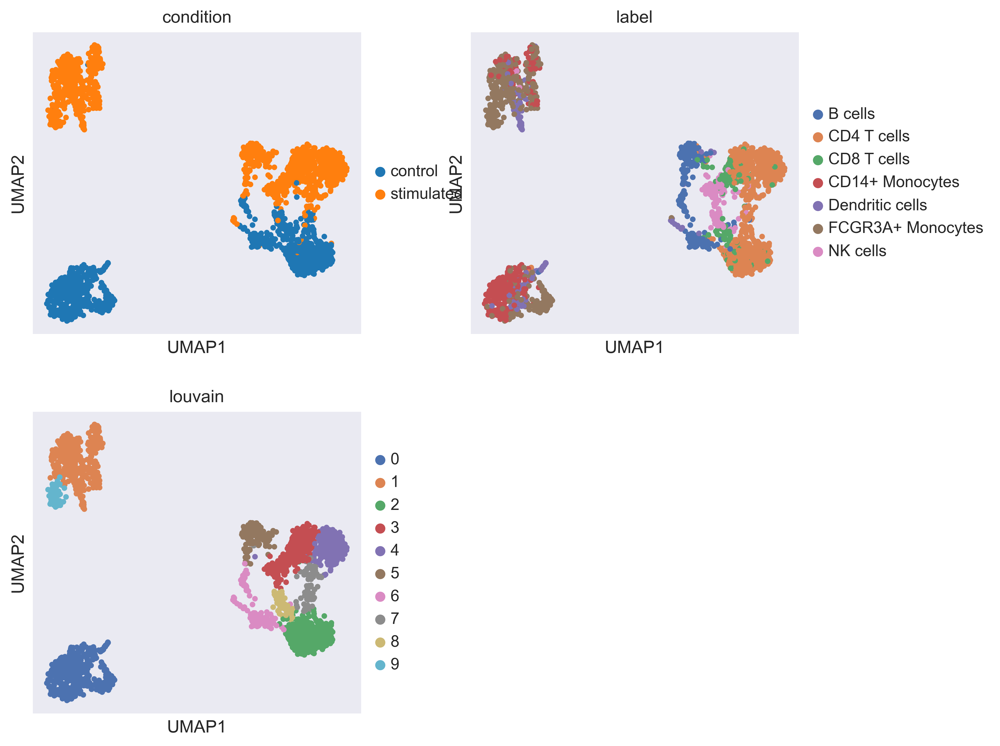

In [67]:
sc.pl.umap(adatakv,
           color=["condition", "label", "louvain",],
           ncols=2,
          )

In [73]:
#df = pd.DataFrame()
df = adatakv.obs.copy()
df[["um1", "um2"]] = adatakv.obsm["X_umap"].copy()
adatakv.obsm
#df

AxisArrays with keys: X_pca, X_umap, X_tsne

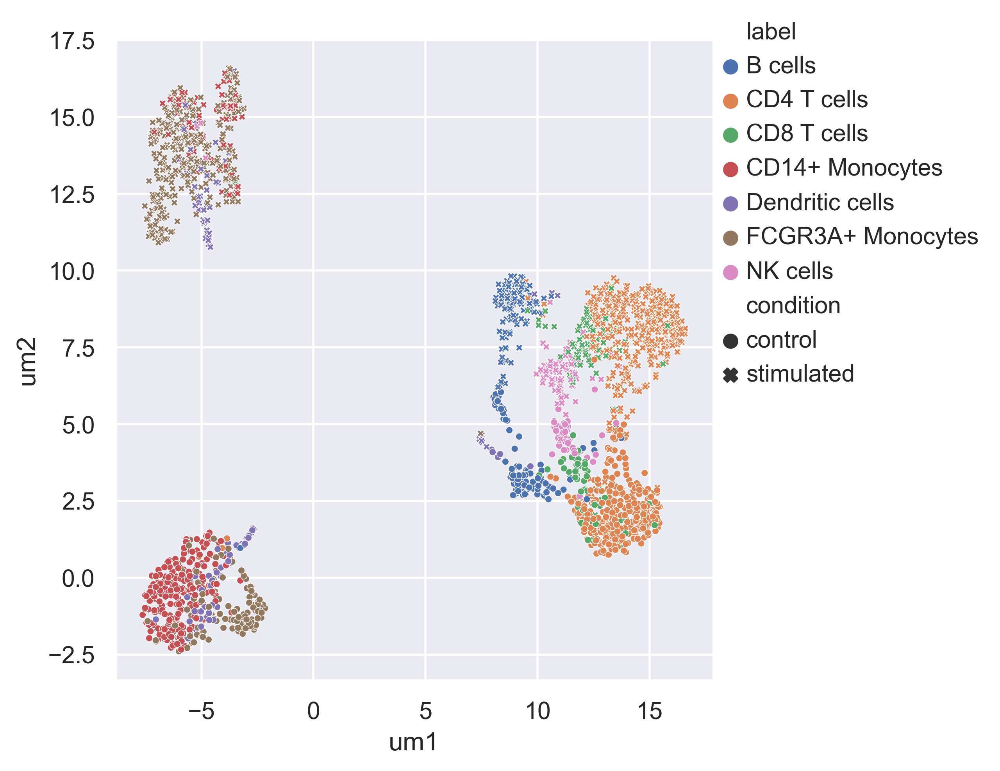

In [88]:
ax=sns.relplot(
    data=df,
    x="um1",
    y="um2",
    hue="label",
    style="condition",
    #size=1e-3,
    s=1e1,
)
sns.move_legend(ax, "upper right",)

In [91]:
model1.cpu()
model1.train()
output = model1(datakv, cond1=conditionskv)
adatakv.obsm["mu_z"] = output["mu_z"].detach().numpy()
adatakv.obsm["z"] = output["z"].detach().numpy()
adatakv.obsm["mu_w"] = output["mu_w"].detach().numpy()
adatakv.obsm["w"] = output["w"].detach().numpy()
adatakv.obs["predict"] = output["q_y"].argmax(-1).detach().numpy().astype(str)
del output
df[["z1","z2",]] = adatakv.obsm["z"]
df[["mu_z1","mu_z2",]] = adatakv.obsm["mu_z"]
df[["w1","w2",]] = adatakv.obsm["w"]
df[["mu_w1","mu_w2",]] = adatakv.obsm["mu_w"]
df["predict"] = adatakv.obs["predict"]
df["predict_int"] = [int(x) for x in adatakv.obs["predict"]]

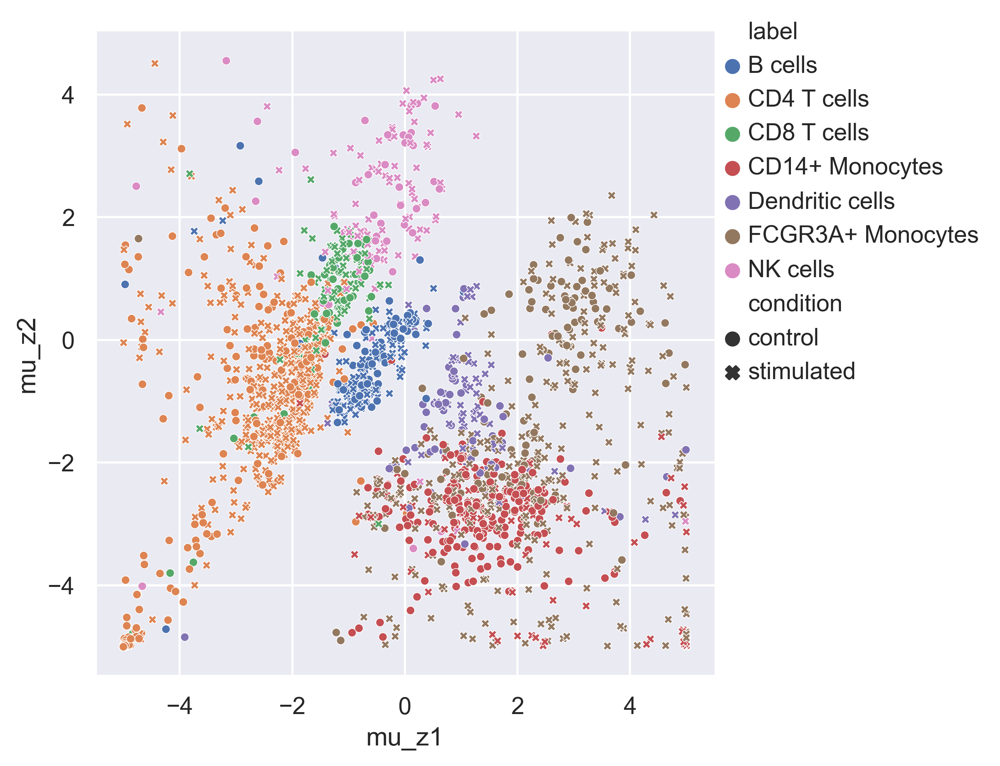

In [95]:
ax=sns.relplot(
    data=df,
    x="mu_z1",
    y="mu_z2",
    hue="label",
    style="condition",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)


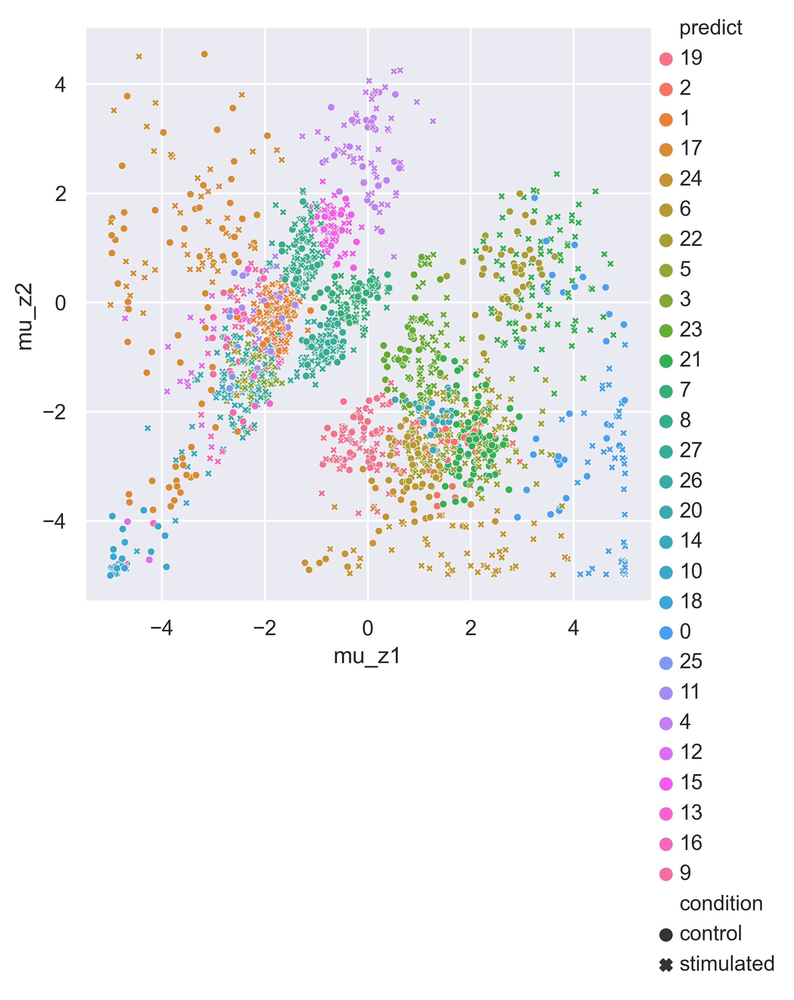

In [96]:
ax=sns.relplot(
    data=df,
    x="mu_z1",
    y="mu_z2",
    hue="predict",
    style="condition",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)


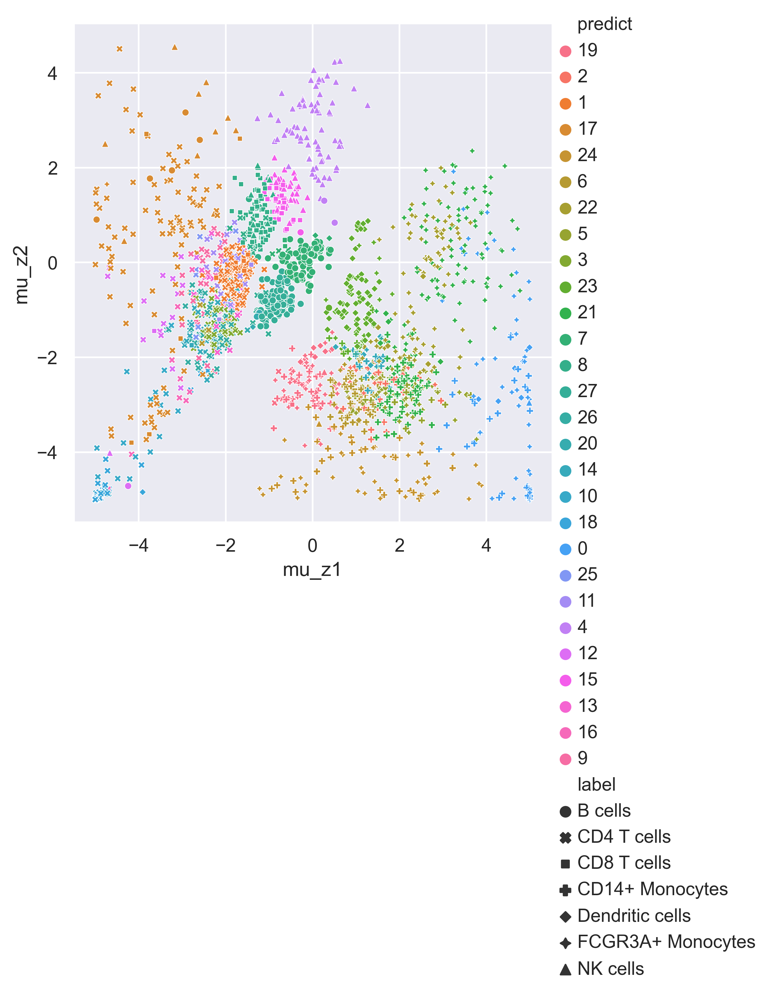

In [98]:
ax=sns.relplot(
    data=df,
    x="mu_z1",
    y="mu_z2",
    hue="predict",
    style="label",
    s=1.7e1,
)
sns.move_legend(ax, "upper right",)


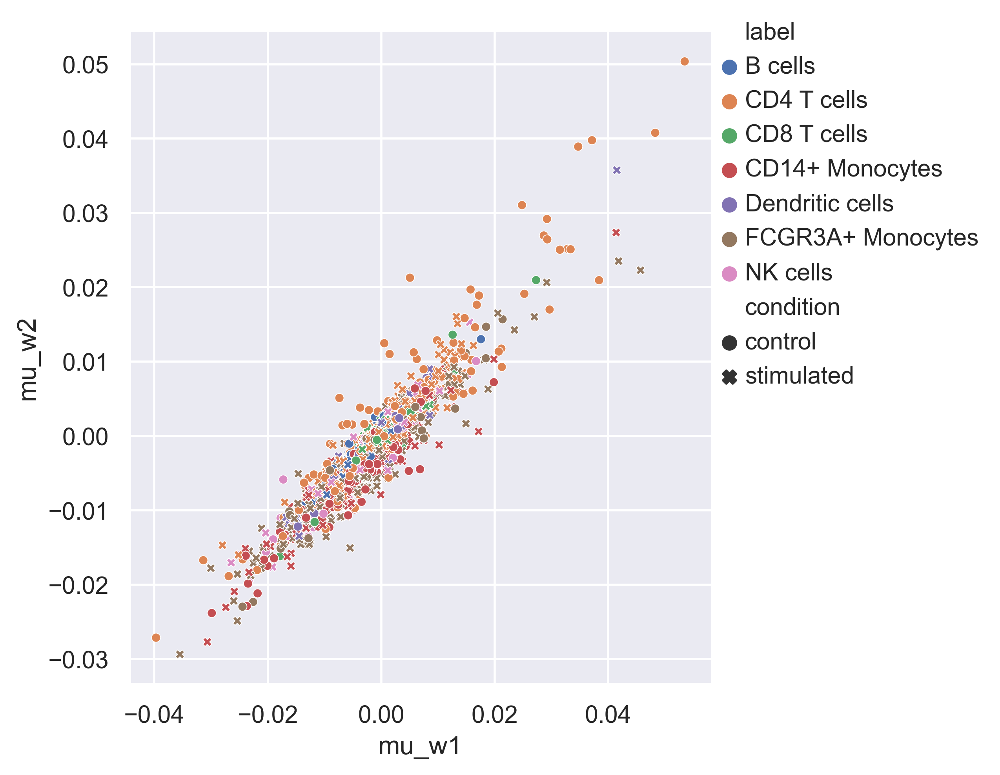

In [100]:
ax=sns.relplot(
    data=df,
    x="mu_w1",
    y="mu_w2",
    hue="label",
    style="condition",
    s=1.7e1,
)
sns.move_legend(ax, "upper right",)

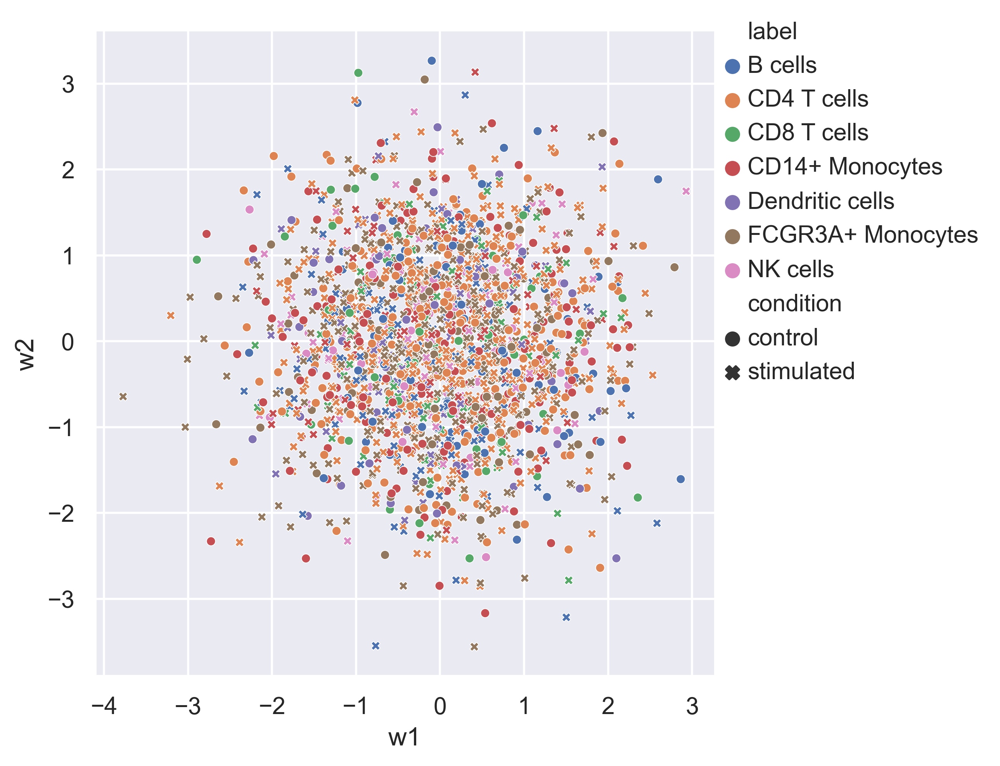

In [102]:
ax=sns.relplot(
    data=df,
    x="w1",
    y="w2",
    hue="label",
    style="condition",
    s=1.7e1,
)
sns.move_legend(ax, "upper right",)

## Moving on to supervised training

In [209]:
model2 = Mb0.VAE_Dirichlet_GMM_TypeB1602zC2(
    nx=adatakt.n_vars,
    nz=24,
    nw=24,
    nclasses=labelskt.shape[1],
    nc1=conditionskt.shape[1],
    #concentration=0.5e-1,
    concentration=1e0,
    dropout=15e-2,
    bn=True,
    reclosstype="mse",
    #reclosstype="Gauss",
    restrict_w=True,
    restrict_z=True,
    positive_rec=True,
    #jnh=2**12,
    #jnhp=2**12,
    #jnhq=2**12,
    numhidden=4,
    numhiddenp=4,
    numhiddenq=4,
    #learned_prior=True,
    learned_prior=False,
)
model2.apply(init_weights)
print()

In [212]:
model2.load_state_dict(
    torch.load("results/Kang_ss_cond_prior_model21671022818.509579model_state.pt",))

<All keys matched successfully>

In [216]:
Train.trainSemiSuperLoopCond(
    model2,
    #labeled_loader,
    #unlabeled_loader,
    #train_loader,
    #z_loader,
    train_loader,
    train_loader,
    train_loader,
    #test_loader,
    num_epochs=10,
    lrs = [
        1e-5,
        1e-4,
        1e-3,
        1e-3,
        1e-4,
        1e-5,
        1e-6,
    ],
    test_accuracy=False,
    report_interval=0,
    wt=1e-5,
    #do_unlabeled=True,
    do_unlabeled=False,
    do_validation=False,
)

epoch's lr =  1e-05
epoch's lr =  0.0001
epoch's lr =  0.001
epoch's lr =  0.001
epoch's lr =  0.0001
epoch's lr =  1e-05
epoch's lr =  1e-06
done training


In [217]:
#reload(ut)
r,p,s = ut.estimateClusterImpurity(model2, datakt, labelskt, "cpu", conditionskt )
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kt_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())
r,p,s = ut.estimateClusterImpurity(model2, datakv, labelskv, "cpu", conditionskv)
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kv_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())

[0. 1. 2. 3. 4. 5. 6.] [0.99251404 0.98032357 0.99712938 0.99692938 0.98828541 0.98019491
 0.99611273] [1603. 2287. 4877.  977.  939. 3181. 1029.]
kt_acc= 
 0.9897938628886054 0.9902127729587581
[0. 1. 2. 3. 4. 5. 6.] [0.94090909 0.82491582 0.94167852 0.84347826 0.8019802  0.85454545
 0.91935484] [220. 297. 703. 115. 101. 440. 124.]
kv_acc= 
 0.891 0.8752660269421862


In [218]:
ut.saveModelParameters(
        model2,
        "./results/Kang_ss_cond_prior_model2" + str(datetime.timestamp(datetime.now())) + "model_params.pt",
        method="json",
        )

torch.save(
        model2.state_dict(),
        "./results/Kang_ss_cond_prior_model2" + str(datetime.timestamp(datetime.now())) + "model_state.pt",
        )

In [219]:
#ut.loadModelParameter("results/Kang_ss_cond_prior_model21671022603.865799model_params.pt")

In [220]:
#ut.loadModelParameter("results/Kang_ss_cond_prior_model21671022818.507437model_params.pt")

In [222]:
model2.cpu()
model2.train()
output = model2(datakv, cond1=conditionskv)
adatakv.obsm["mu_z"] = output["mu_z"].detach().numpy()
adatakv.obsm["z"] = output["z"].detach().numpy()
adatakv.obsm["mu_w"] = output["mu_w"].detach().numpy()
adatakv.obsm["w"] = output["w"].detach().numpy()
adatakv.obs["predict"] = output["q_y"].argmax(-1).detach().numpy().astype(str)
del output
#df[["z1","z2",]] = adatakv.obsm["z"]
#df[["mu_z1","mu_z2",]] = adatakv.obsm["mu_z"]
#df[["w1","w2",]] = adatakv.obsm["w"]
#df[["mu_w1","mu_w2",]] = adatakv.obsm["mu_w"]
df["predict"] = adatakv.obs["predict"]
df["predict_int"] = [int(x) for x in adatakv.obs["predict"]]

In [225]:
#torch.pca_lowrank?
pca = PCA(n_components=2)
pca.fit(adatakv.obsm["mu_z"])

PCA(n_components=2)

In [227]:
df[["pc_muz1", "pc_muz2"]] = pca.transform(adatakv.obsm["mu_z"])

In [228]:
df[["pc_muw1", "pc_muw2"]] = pca.fit_transform(adatakv.obsm["mu_w"])

In [229]:
df[["pc_z1", "pc_z2"]] = pca.fit_transform(adatakv.obsm["z"])
df[["pc_w1", "pc_w2"]] = pca.fit_transform(adatakv.obsm["w"])

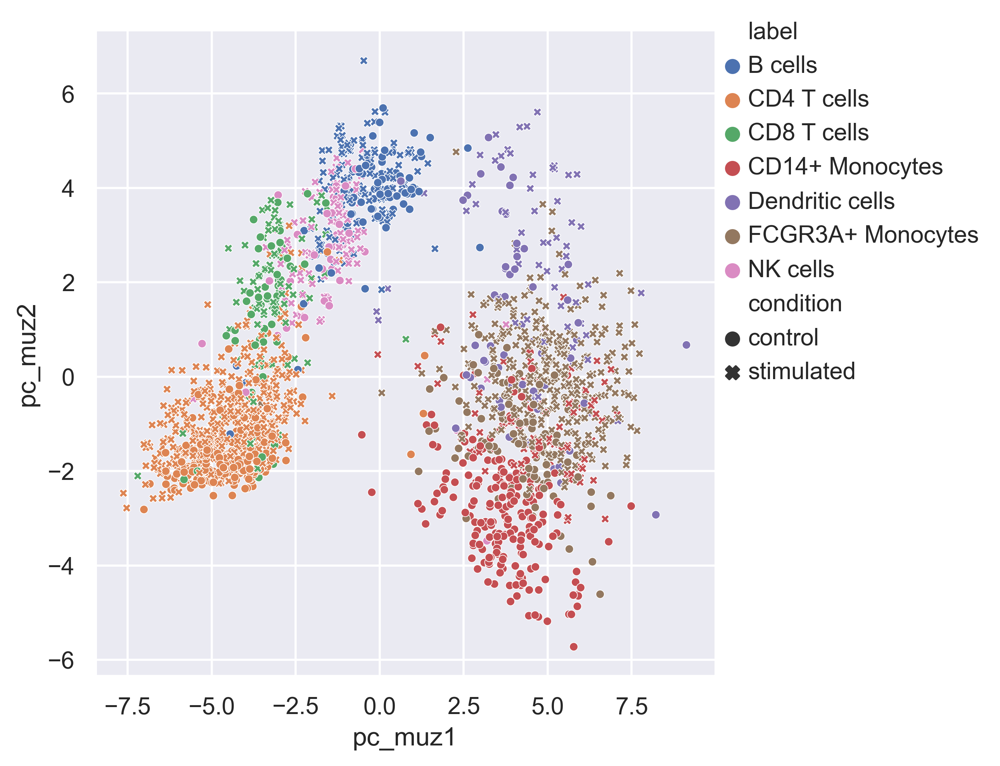

In [231]:
ax=sns.relplot(
    data=df,
    x="pc_muz1",
    y="pc_muz2",
    hue="label",
    style="condition",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)

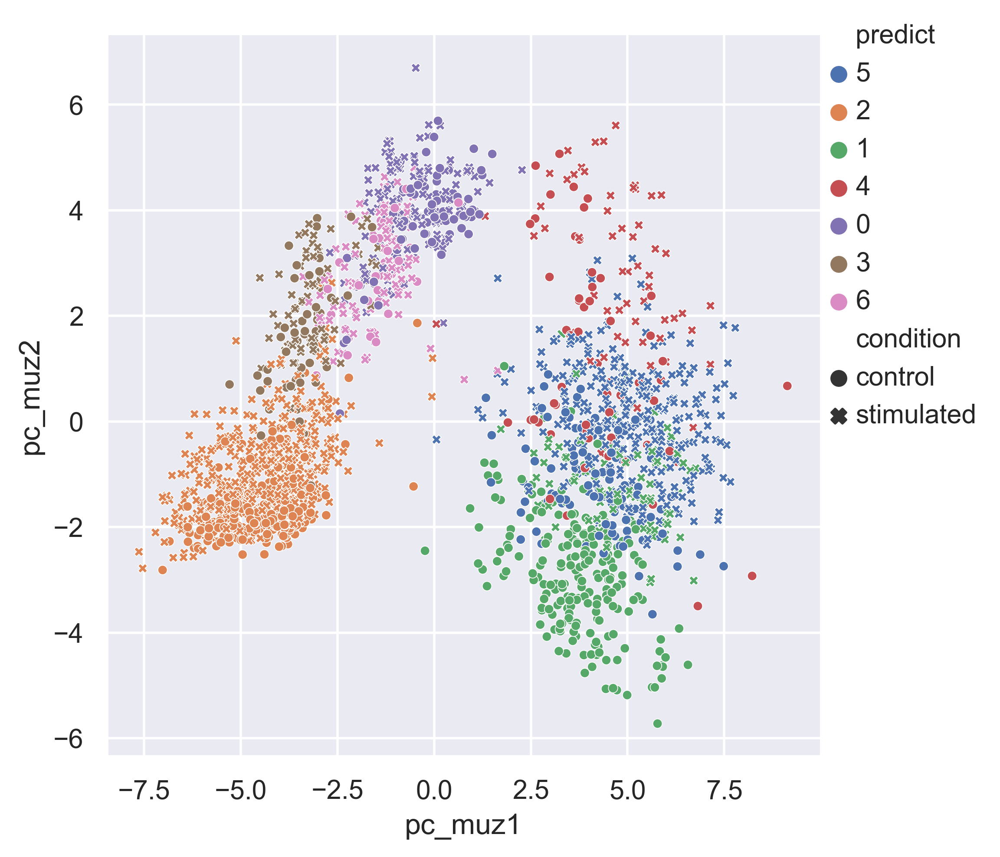

In [512]:
ax=sns.relplot(
    data=df,
    x="pc_muz1",
    y="pc_muz2",
    hue="predict",
    style="condition",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)

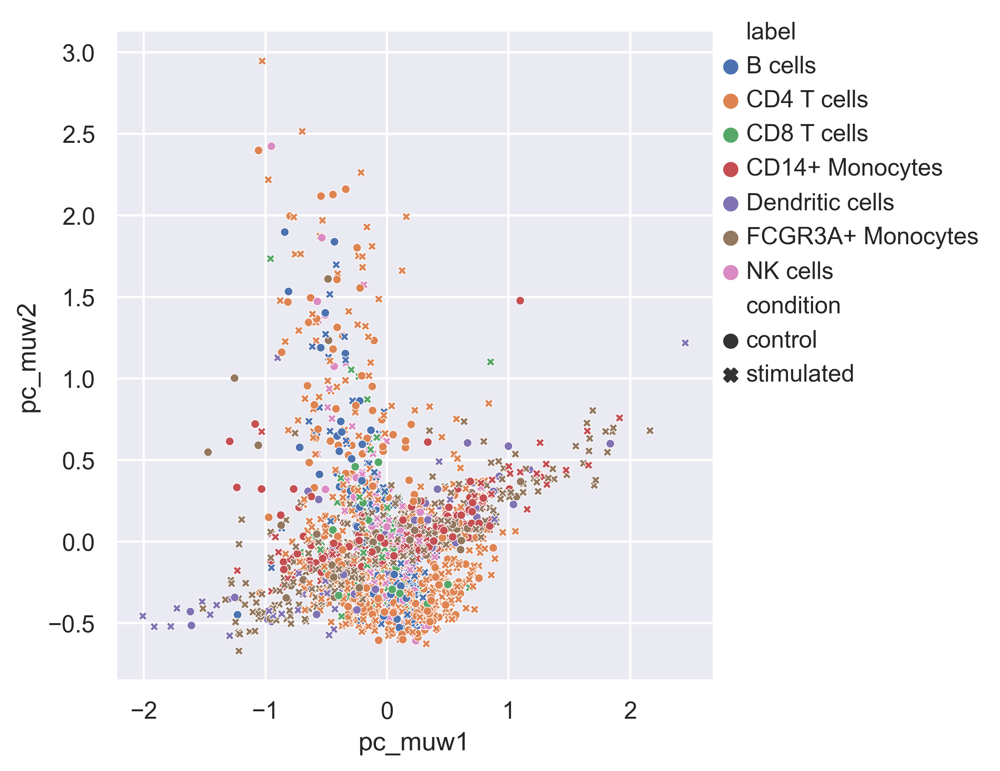

In [232]:
ax=sns.relplot(
    data=df,
    x="pc_muw1",
    y="pc_muw2",
    hue="label",
    style="condition",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)

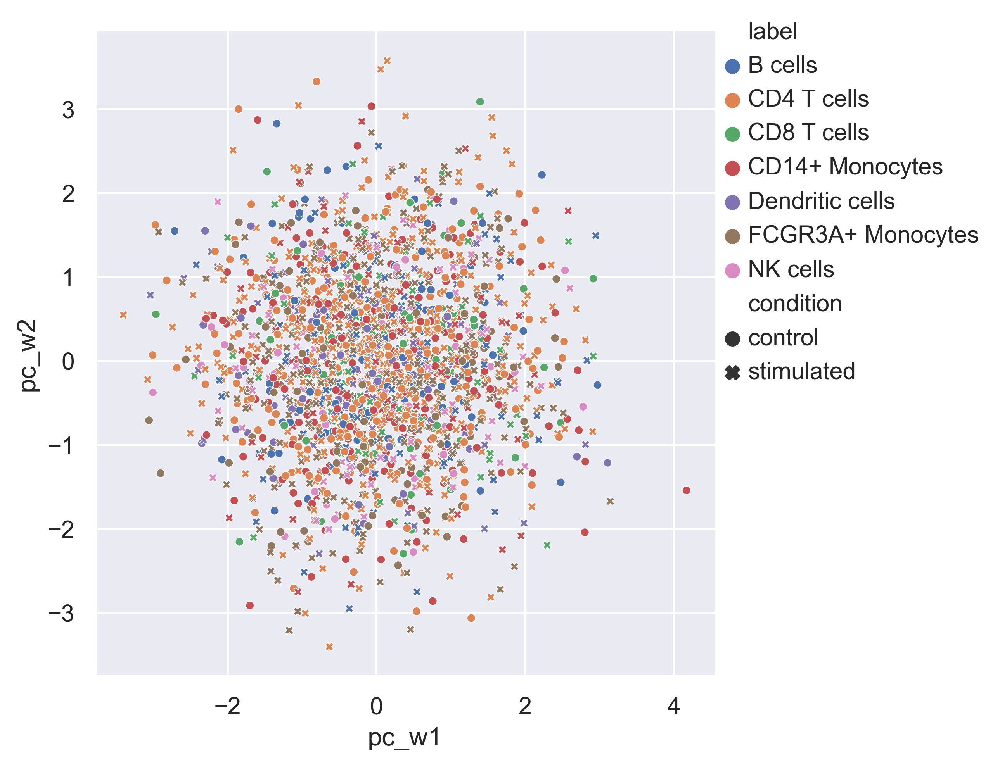

In [233]:
ax=sns.relplot(
    data=df,
    x="pc_w1",
    y="pc_w2",
    hue="label",
    style="condition",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)

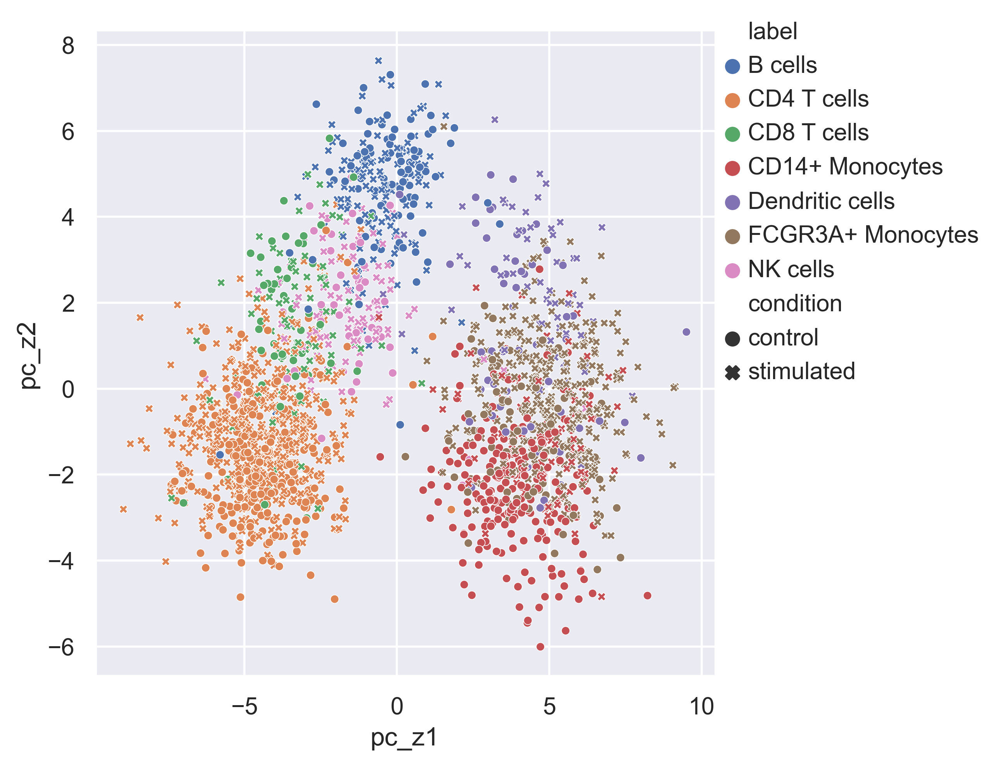

In [234]:
ax=sns.relplot(
    data=df,
    x="pc_z1",
    y="pc_z2",
    hue="label",
    style="condition",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


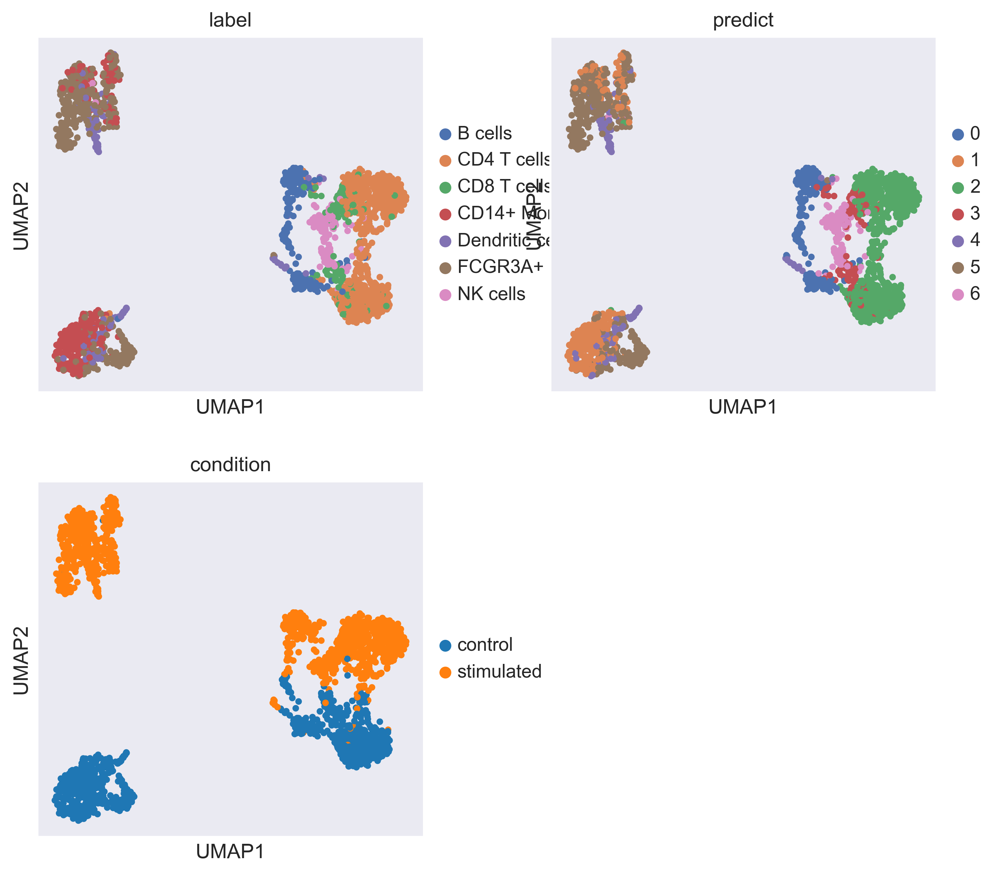

In [237]:
sc.pl.umap(adatakv,
           color=["label", "predict", "condition", ],
           ncols=2,
          )


In [239]:
ctrlMarker =  df["condition"].to_numpy() == "control" 

In [251]:
#reload(ut)
r,p,s = ut.estimateClusterImpurity(model2, datakt, labelskt, "cpu", conditionskt )
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kt_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())
r,p,s = ut.estimateClusterImpurity(model2, datakv, labelskv, "cpu", conditionskv)
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kv_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())

[0. 1. 2. 3. 4. 5. 6.] [0.995625   0.98712256 0.99835796 0.99390244 0.98087141 0.97110006
 0.99317739] [1600. 2252. 4872.  984.  941. 3218. 1026.]
kt_acc= 
 0.9887195326663534 0.9885938320115294
[0. 1. 2. 3. 4. 5. 6.] [0.9537037  0.82926829 0.93785311 0.84070796 0.78095238 0.83820225
 0.92063492] [216. 287. 708. 113. 105. 445. 126.]
kv_acc= 
 0.887 0.8716175167301924


In [258]:
r,p,s = ut.estimateClusterImpurity(model2, datakv[ctrlMarker], labelskv[ctrlMarker], "cpu", conditionskv[ctrlMarker])
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kv_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())


[0. 1. 2. 3. 4. 5. 6.] [0.96808511 0.87962963 0.93159609 0.875      0.82       0.72868217
 0.92857143] [ 94. 216. 307.  48.  50. 129.  42.]
kv_acc= 
 0.8837471783295711 0.8759377751902692


In [270]:
model2.train()
out0 = model2(input=datakv[ctrlMarker],
                         y=labelskv[ctrlMarker],
                         cond1=conditionskv[ctrlMarker],
                        )
mu_zs = out0["mu_z"].detach()
zs = out0["z"].detach()
mu_ws = out0["mu_w"].detach()
ws = out0["w"].detach()

In [275]:
cs = 1-conditionskv[ctrlMarker]
ys=labelskv[ctrlMarker]

In [276]:
xs = model2.Px(
    torch.cat([mu_zs, cs], dim=-1),)

In [277]:
r,p,s = ut.estimateClusterImpurity(model2, xs, labelskv[ctrlMarker], "cpu", 1-conditionskv[ctrlMarker])
print(p,r,s)
r = r[r>=0]
s = s[s>=0]
print("kv_acc= \n", (r*s).sum().item() / s.sum().item(), r.mean().item())

[0. 1. 2. 3. 4. 5. 6.] [0.96629213 0.96183206 0.90734824 0.84444444 0.77083333 0.49765258
 0.82978723] [ 89. 131. 313.  45.  48. 213.  47.]
kv_acc= 
 0.8081264108352144 0.8254557189559456


In [311]:
zss = model2.Pz(
    torch.cat([mu_ws, cs], dim=-1),)
    

In [312]:
#adatakt.obs[["cell_type", "label", "label_num"]][:50]
#adatakv.obs[["cell_type", "label", "label_num"]][:50]
ys.unsqueeze(-1).shape
zss.shape
zss = ys.unsqueeze(-1) * zss
#zsss
#recs = model2.Px(
#    torch.cat([zss, cs], dim=-1),)

In [314]:
zss.sum(1).shape

torch.Size([886, 48])

In [315]:
zss = zss.sum(1)
zss = zss[:,:model2.nz]
zss.shape

torch.Size([886, 24])

In [316]:
zss.shape, cs.shape
xs = model2.Px(
    torch.cat([zss, cs], dim=-1),)

In [328]:
out1 = model2(input=xs, cond1=cs)

In [329]:
torch.sum(out1["q_y"].argmax(-1).detach() == ys.argmax(-1)) / ys.shape[0]

tensor(0.9797)

In [326]:
ys.shape

torch.Size([886, 7])

In [334]:
conditionskv[ctrlMarker] + cs

tensor([[1., 1.],
        [1., 1.],
        [1., 1.],
        ...,
        [1., 1.],
        [1., 1.],
        [1., 1.]])

In [344]:
adata = sc.read_h5ad("data/scgen/scGen_datasets/valid_study.h5ad",)
adata.X = adata.X.toarray()
adata.obs[["label", "label_num"]] = adatakv.obs[["label", "label_num"]]
bdata = adata[ctrlMarker].copy()
bdata.X = xs.detach().numpy()

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/anndata/compat/__init__.py:232: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [350]:
bdata.obs["group"] = bdata.n_obs * ["converted_to_stim"]
adata.obs["group"] = adatakv.obs["condition"].copy()

In [352]:
#adata.obs
#bdata.obs

In [356]:
xdata = ad.concat([adata, bdata], label="set", join="inner",)
xdata.var_names_make_unique()
xdata.obs_names_make_unique()
#xdata.obs

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [357]:
sc.pp.pca(xdata,)
sc.pp.neighbors(xdata,)
sc.tl.umap(xdata,)

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


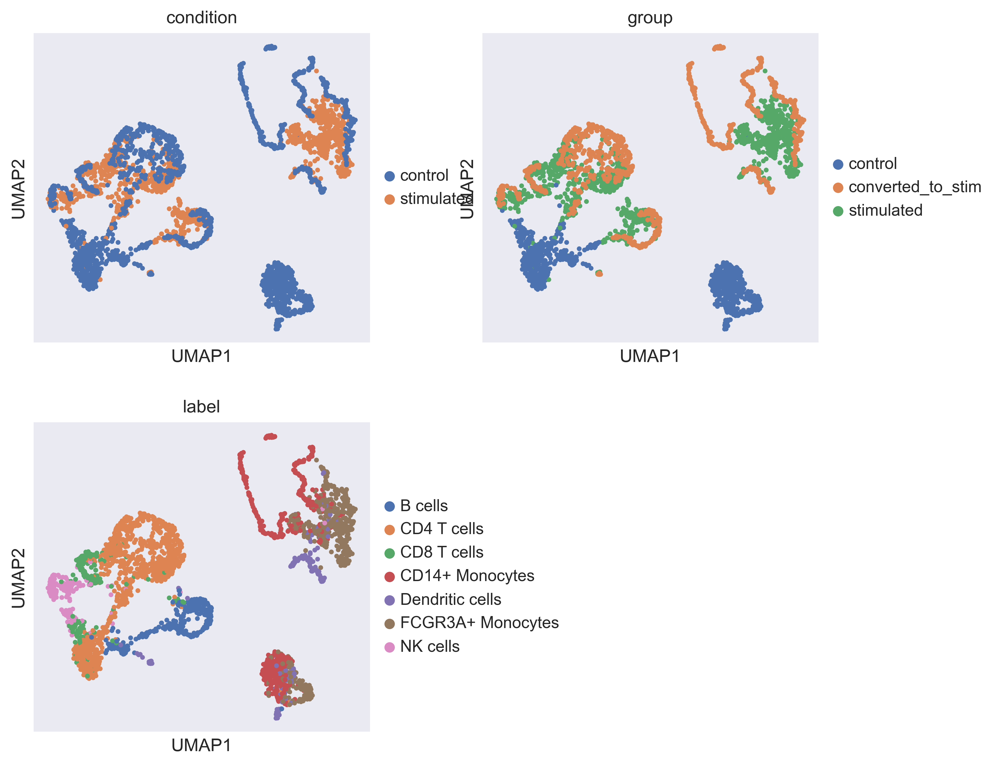

In [359]:
sc.pl.umap(xdata,
           color=["condition", "group",
                  "label", ],
           ncols=2,
          )

In [360]:
sc.pp.pca(adata,)
sc.pp.neighbors(adata,)
sc.tl.umap(adata,)

sc.pp.pca(bdata,)
sc.pp.neighbors(bdata,)
sc.tl.umap(bdata,)

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


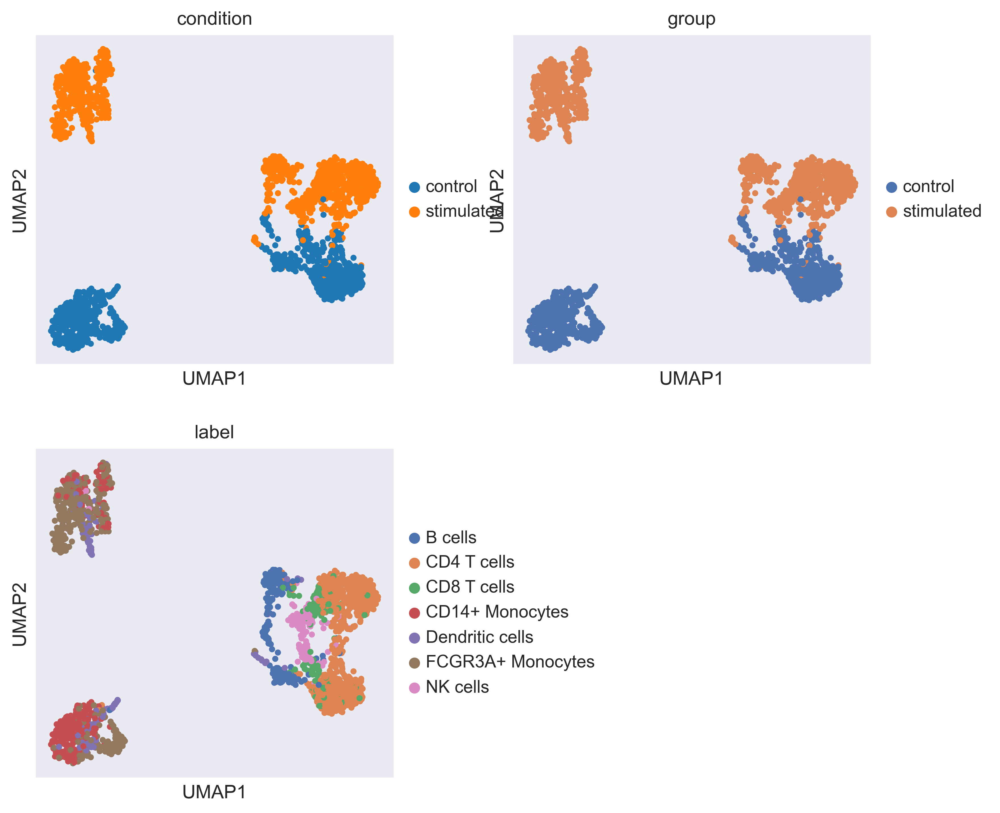

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


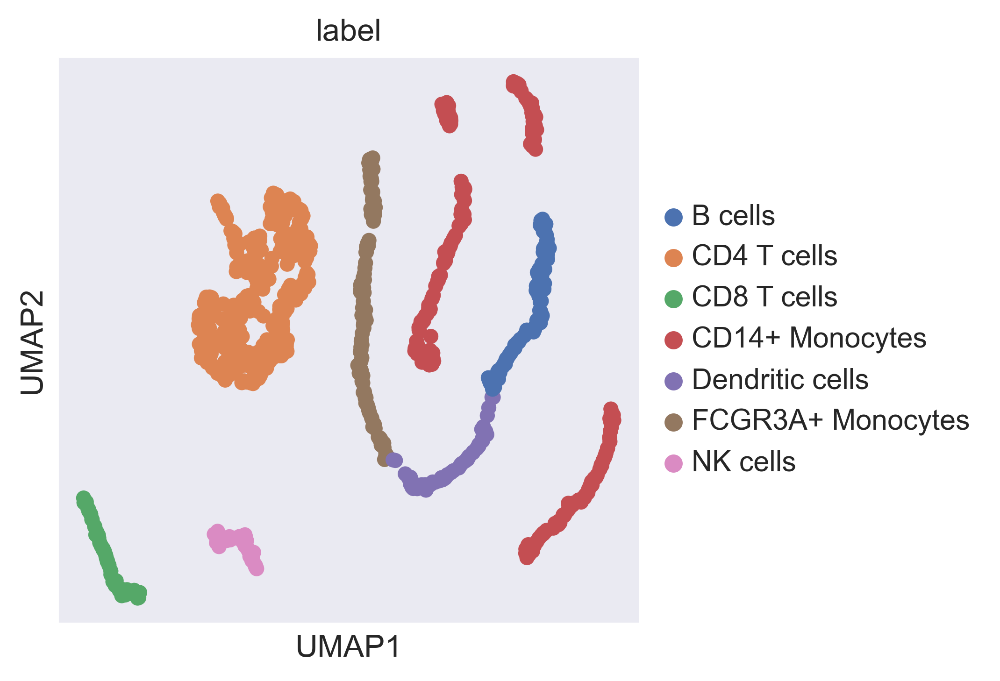

In [362]:
sc.pl.umap(adata,
           color=["condition", "group",
                  "label", ],
           ncols=2,
          )
sc.pl.umap(bdata,
           color=[
                  "label", ],
           ncols=2,
          )


In [364]:
xdata.obs[["um1", "um2"]] = xdata.obsm["X_umap"].copy()

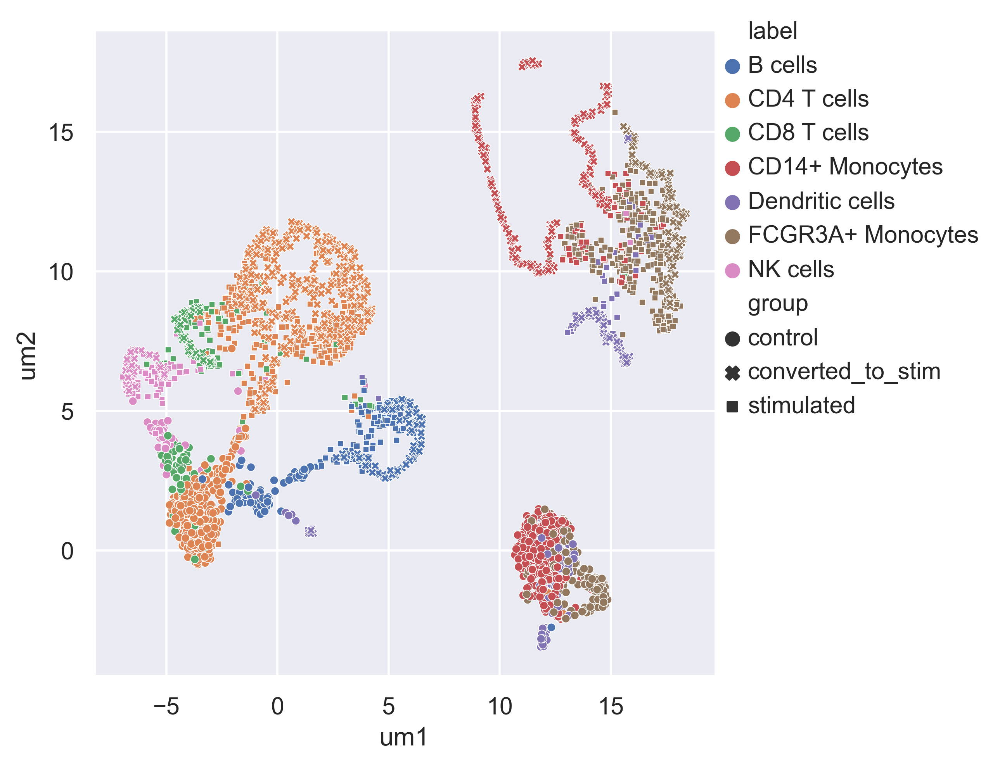

In [365]:
ax=sns.relplot(
    data=xdata.obs,
    x="um1",
    y="um2",
    hue="label",
    style="group",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)


In [368]:
xdata.obs[["pc1", "pc2", "pc3"]] = xdata.obsm["X_pca"][:,:3].copy()


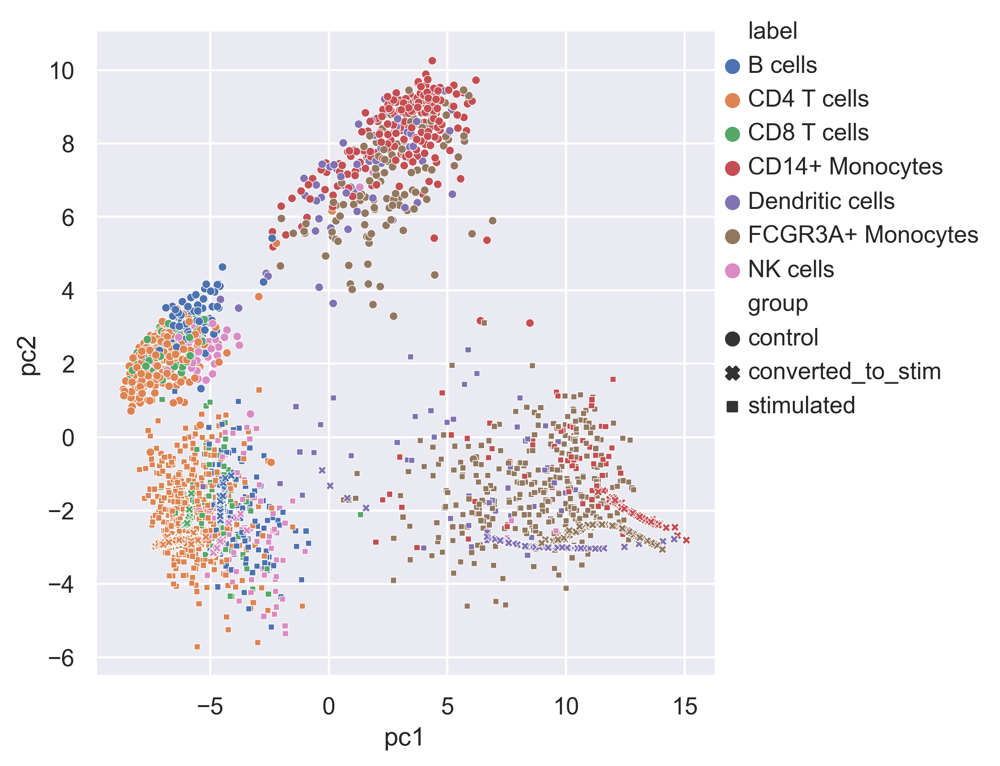

In [369]:
ax=sns.relplot(
    data=xdata.obs,
    x="pc1",
    y="pc2",
    hue="label",
    style="group",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)


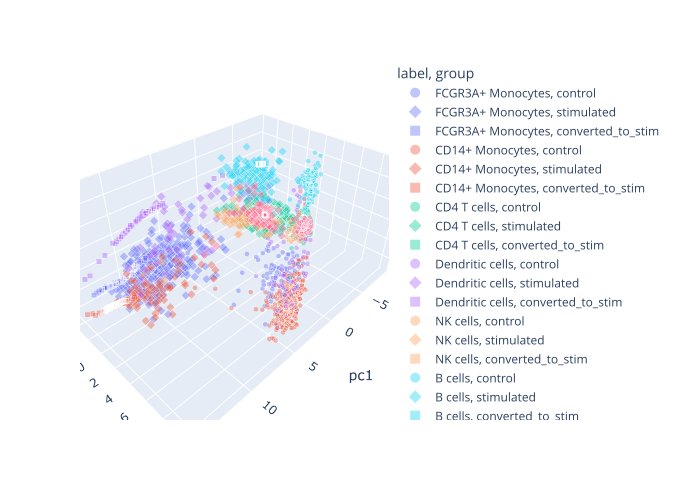

In [370]:
fig = px.scatter_3d(xdata.obs,
                    x="pc1",y="pc2",z="pc3",
                    color="label",
                    symbol="group",
                    size_max=8,
                    size=np.ones(len(xdata.obs))*1,
                    opacity=0.4
                    )
fig.show(renderer="svg",)

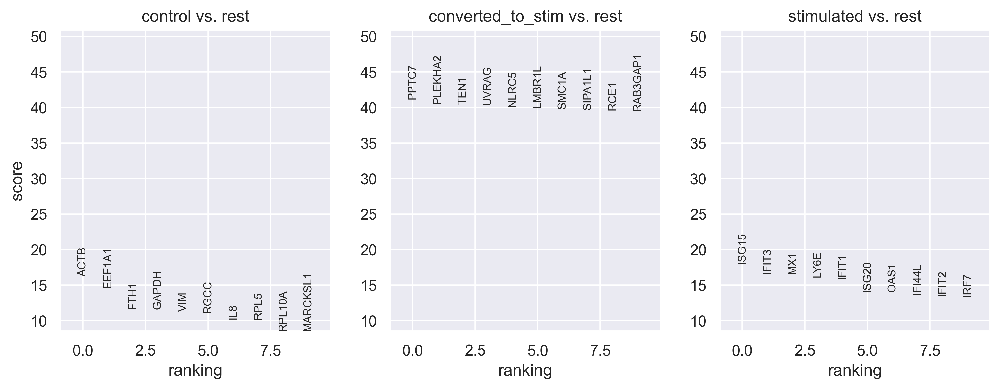

In [374]:
sc.tl.rank_genes_groups(xdata, groupby="group", method="wilcoxon")
sc.pl.rank_genes_groups(xdata, n_genes=10, cmap="viridis",)

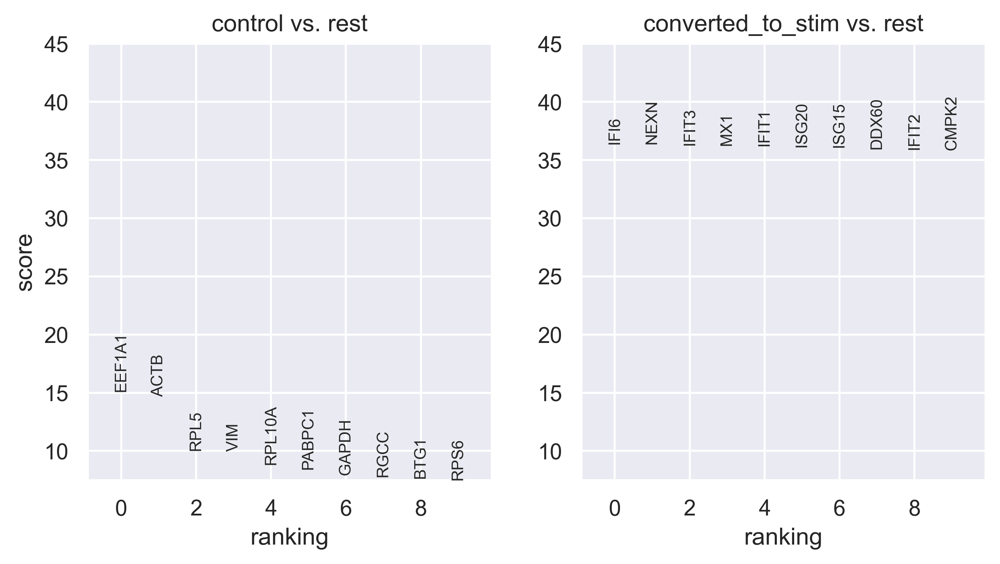

In [375]:
ydata = xdata[xdata.obs["group"] != "stimulated"].copy()
sc.tl.rank_genes_groups(ydata, groupby="group", method="wilcoxon")
sc.pl.rank_genes_groups(ydata, n_genes=10, cmap="viridis",)

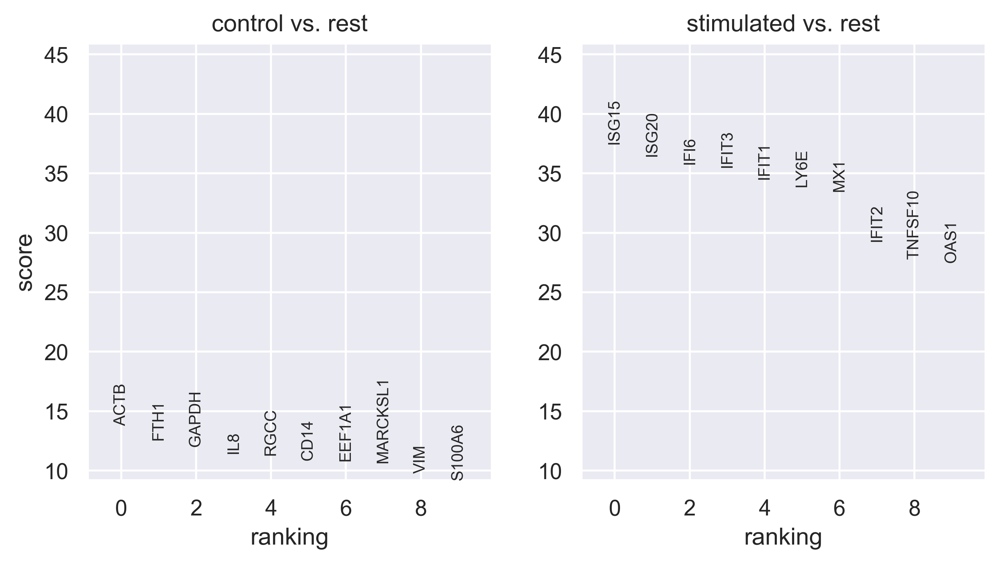

In [376]:
sc.tl.rank_genes_groups(adata, groupby="group", method="wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=10, cmap="viridis",)

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored



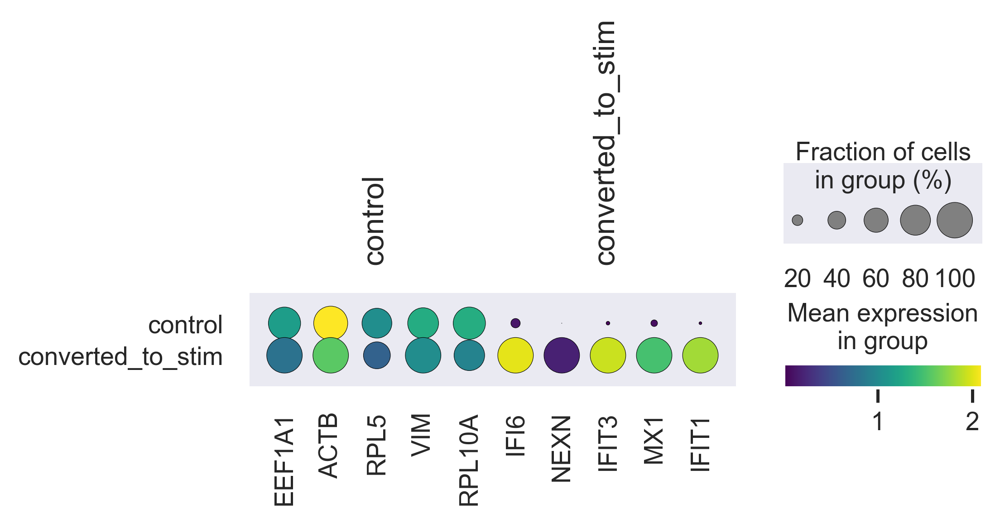

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored



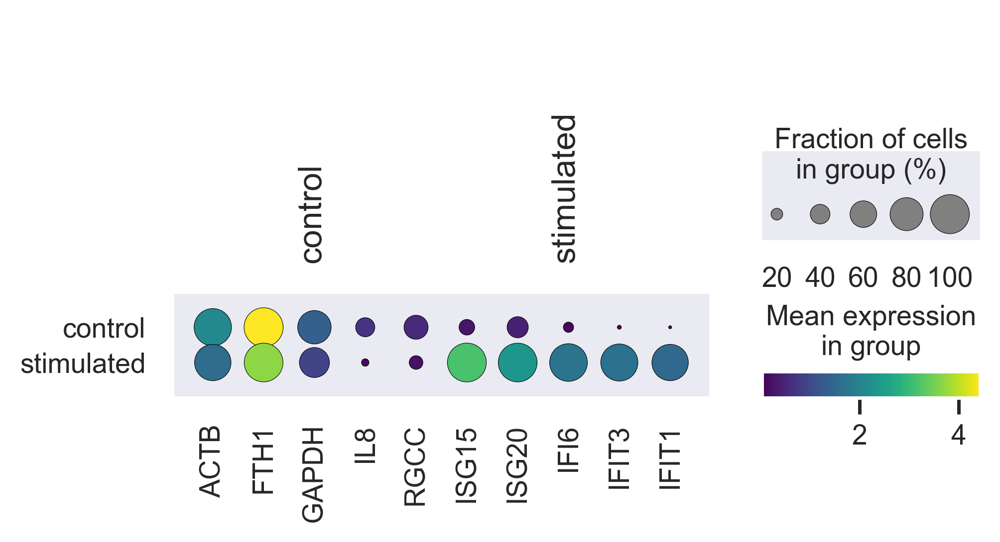

In [380]:
sc.pl.rank_genes_groups_dotplot(ydata, n_genes=5, cmap="viridis", dendrogram=False,)
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, cmap="viridis", dendrogram=False,)

In [381]:
enc_labels.classes_

array(['B cells', 'CD14+ Monocytes', 'CD4 T cells', 'CD8 T cells',
       'Dendritic cells', 'FCGR3A+ Monocytes', 'NK cells'], dtype=object)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


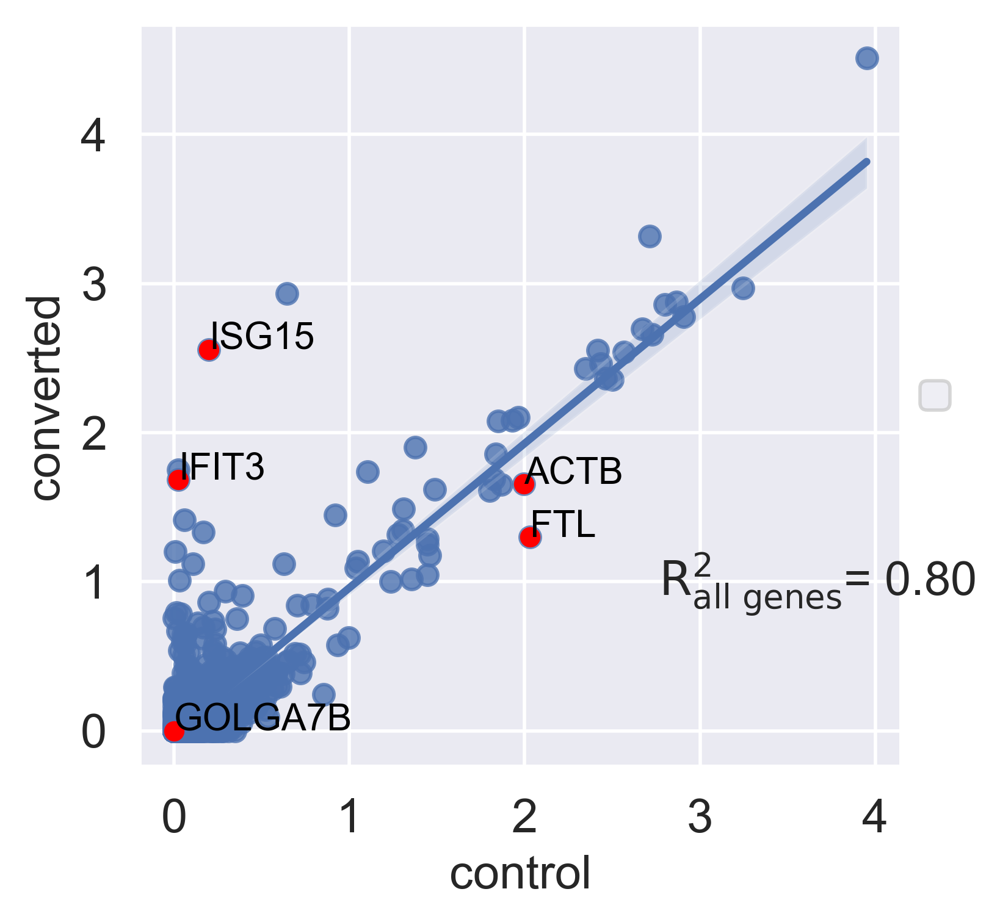

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


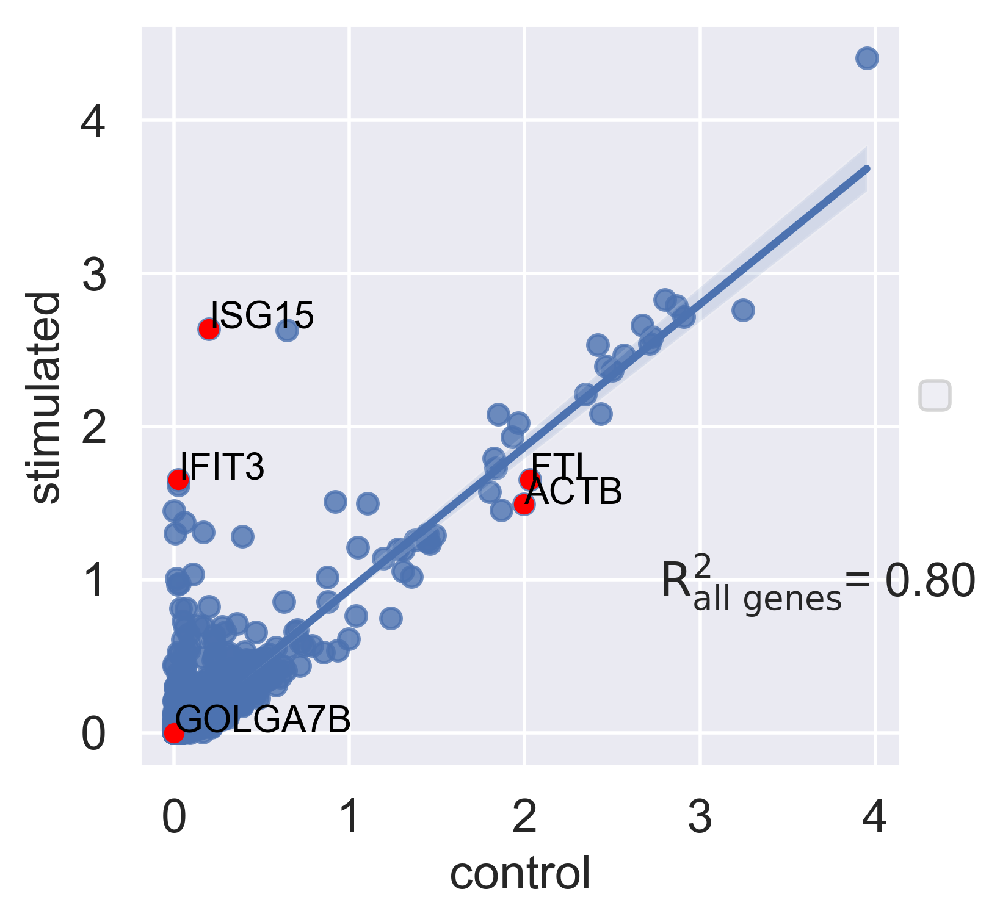

0.797751742592681

In [391]:
bmark = ydata.obs["label_num"] == "0"
ut.reg_mean_plot(ydata[bmark], show=True, condition_key="group",
                 axis_keys={"x" : "control", "y" : "converted_to_stim",},
                 labels={"x" : "control", "y" : "converted"},
                gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )
bmark = adata.obs["label_num"] == "0"
ut.reg_mean_plot(adata[bmark], show=True, condition_key="group",
                 axis_keys={"x" : "control", "y" : "stimulated",},
                 labels={"x" : "control", "y" : "stimulated"},
                gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )

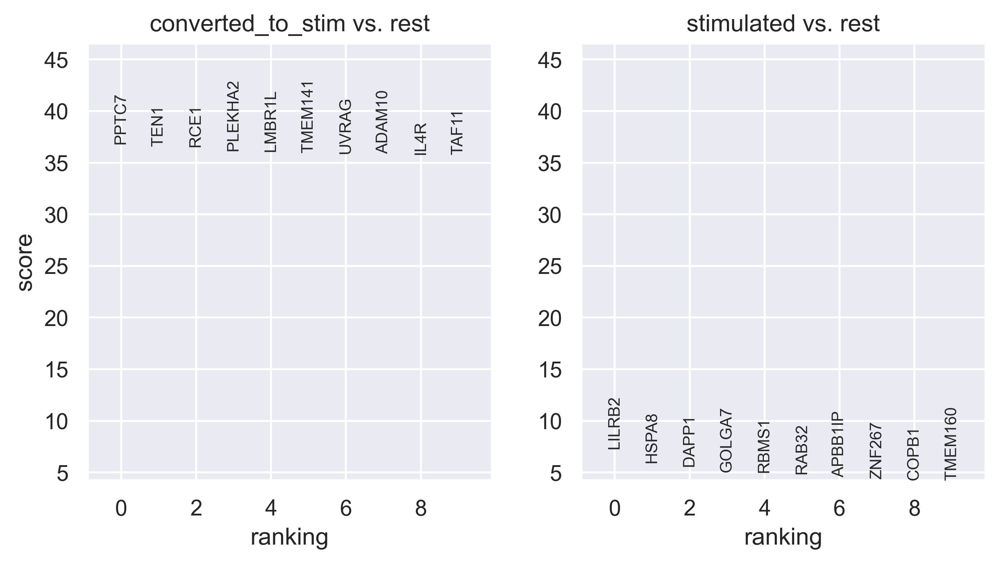

In [392]:
zdata = xdata[xdata.obs["group"] != "control"].copy()
sc.tl.rank_genes_groups(zdata, groupby="group", method="wilcoxon")
sc.pl.rank_genes_groups(zdata, n_genes=10, cmap="viridis",)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


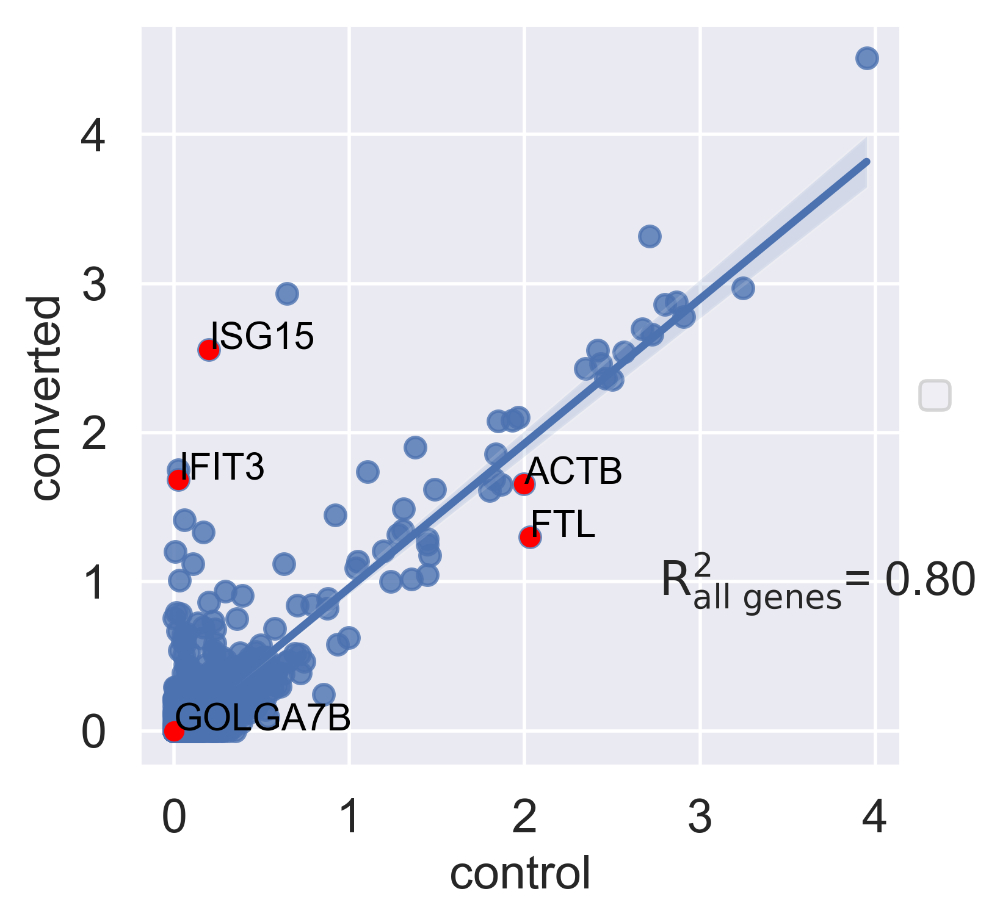

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


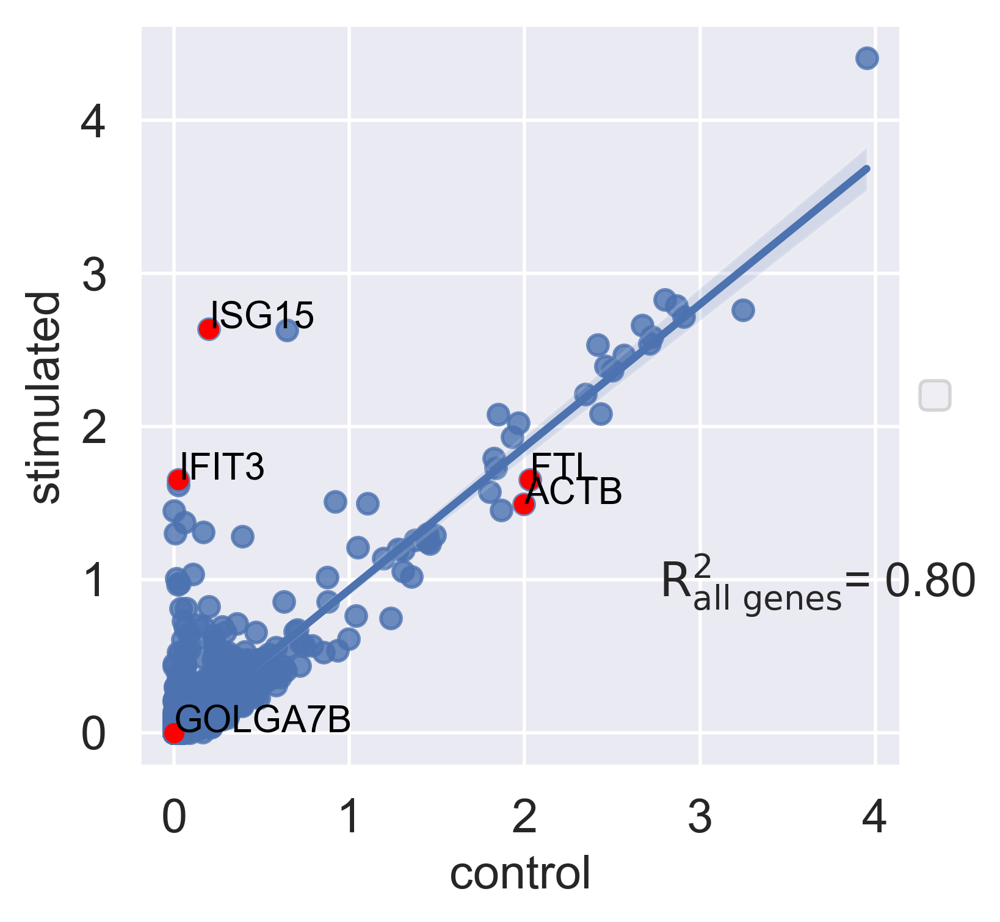

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


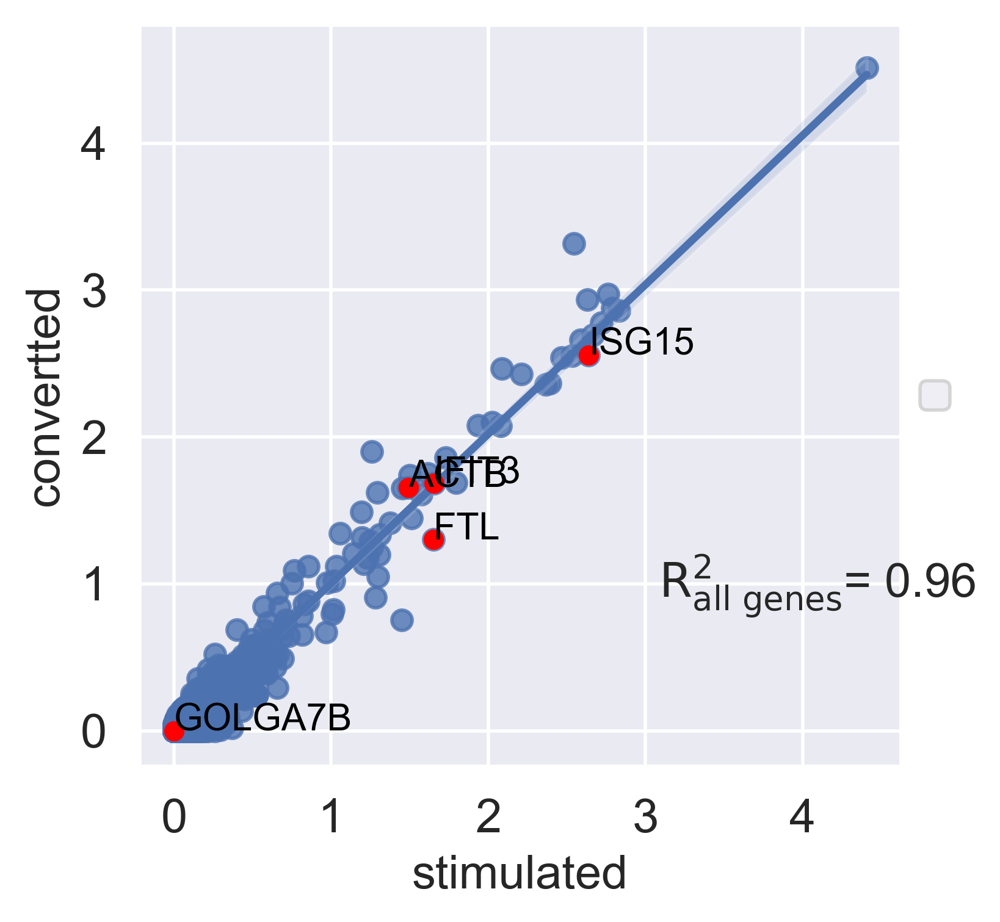

0.9569675348473701

In [395]:
bmark = ydata.obs["label_num"] == "0"
ut.reg_mean_plot(ydata[bmark], show=True, condition_key="group",
                 axis_keys={"x" : "control", "y" : "converted_to_stim",},
                 labels={"x" : "control", "y" : "converted"},
                gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )
bmark = adata.obs["label_num"] == "0"
ut.reg_mean_plot(adata[bmark], show=True, condition_key="group",
                 axis_keys={"x" : "control", "y" : "stimulated",},
                 labels={"x" : "control", "y" : "stimulated"},
                gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )
bmark = zdata.obs["label_num"] == "0"
ut.reg_mean_plot(zdata[bmark], show=True, condition_key="group",
                 axis_keys={"x" : "stimulated", "y" : "converted_to_stim",},
                 labels={"x" : "stimulated", "y" : "convertted"},
                gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


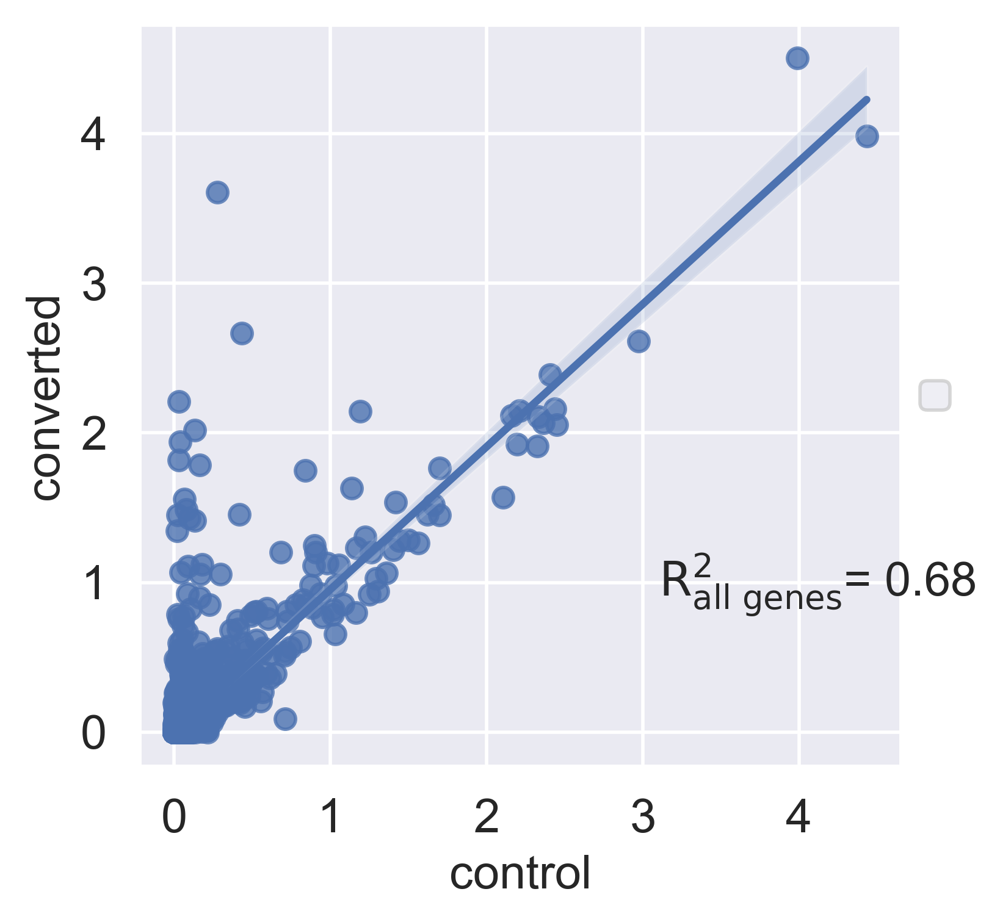

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


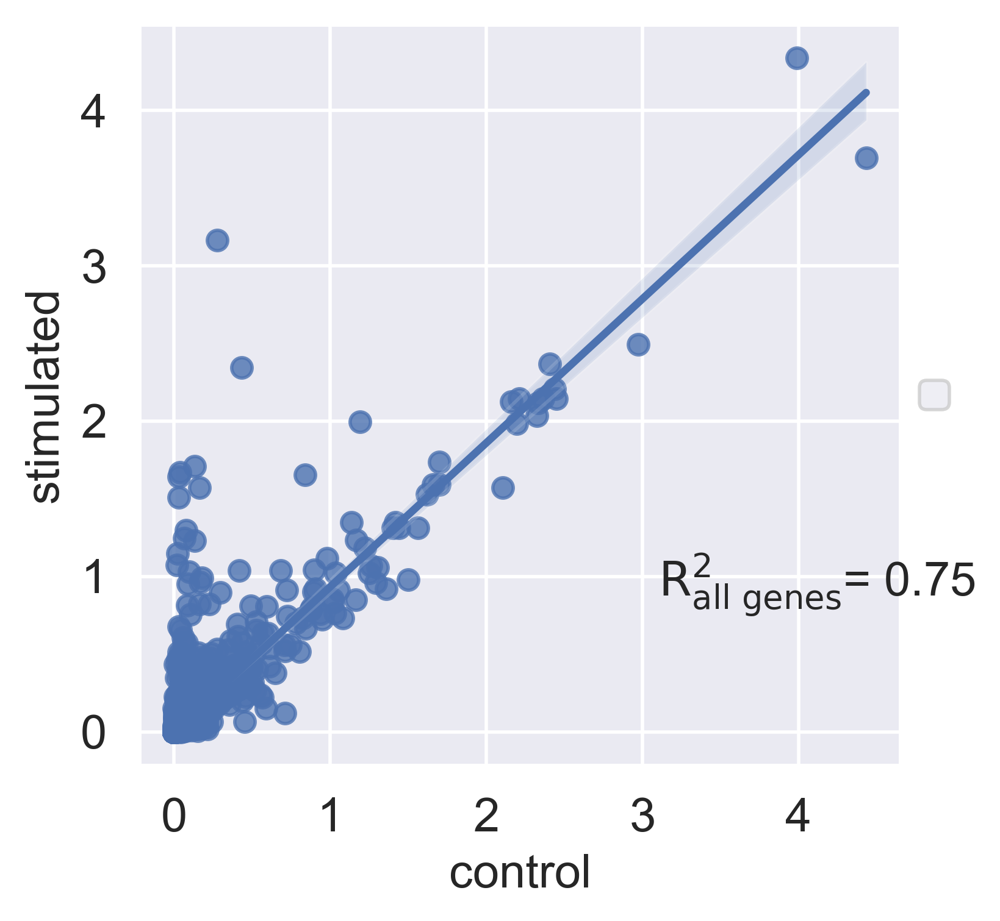

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


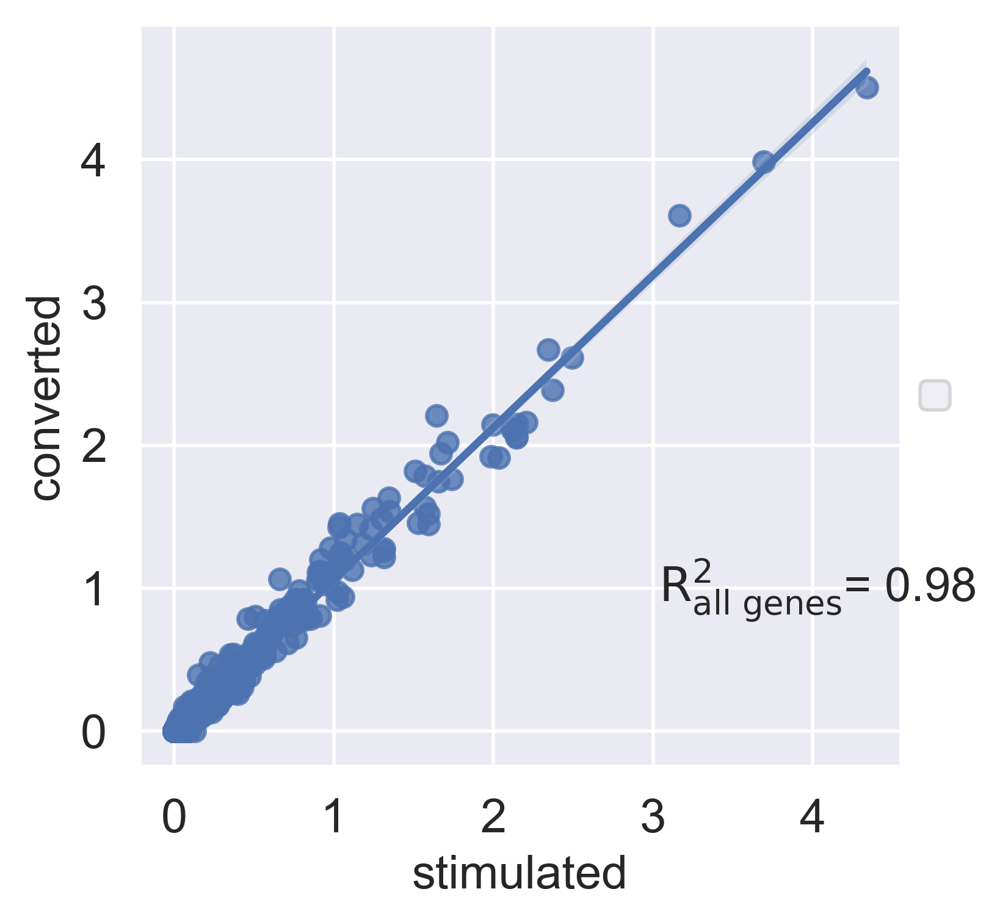

0.9812403992312614

In [397]:
ut.reg_mean_plot(xdata, show=True, condition_key="group",
                 axis_keys={"x" : "control", "y" : "converted_to_stim",},
                 labels={"x" : "control", "y" : "converted"},
                #gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )
ut.reg_mean_plot(xdata, show=True, condition_key="group",
                 axis_keys={"x" : "control", "y" : "stimulated",},
                 labels={"x" : "control", "y" : "stimulated"},
                #gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )
ut.reg_mean_plot(xdata, show=True, condition_key="group",
                 axis_keys={"x" : "stimulated", "y" : "converted_to_stim",},
                 labels={"x" : "stimulated", "y" : "converted"},
                #gene_list=["ACTB", "FTL","ISG15","IFIT3","GOLGA7B",],
                )

#### Next todo: generation
A cVAE could probably do the above since we are using the celltype information.
We could take a bunch of "B-cells" of the control group, and convert them to "stimulated" with the cVAE.
However with the cGMVAE we can also generate synthetic data- sample from the $w$-space, and project from it to all classes and conditions. This is what we show next.

In [420]:
wg = torch.randn(200, model2.nw)
cg = torch.zeros(200, 2)
cg[:100,1] = 1 #stimulated
cg[100:,0] = 1 #stimulated

In [424]:
#adatakv.obs['condition']
#conditionskv
wg.shape
cg.shape
zg = model2.Pz(
    torch.cat([wg,cg], dim=-1),)
zg.shape

torch.Size([200, 7, 48])

In [437]:
zg.shape
#mu_zg = zg.reshape(-1,model2.nz*2)[:,:model2.nz]
mu_zg = zg[:,:,:model2.nz]
mu_zg.shape
cg.unsqueeze(1).shape
cgs = cg.unsqueeze(1) * torch.ones(1,7,1)

In [447]:
mu_zg.shape, cgs.shape
torch.cat([mu_zg, mu_zg], dim=2).shape
torch.cat([mu_zg, cgs], dim=-1).shape

torch.Size([200, 7, 26])

In [450]:
Xg = model2.Px(
    torch.cat([mu_zg, cgs], dim=-1).reshape(-1,model2.nz+model2.nc1),)

In [455]:
gdata = sc.AnnData(X = Xg.detach().numpy(), )
gdata.var_names = adatakv.var_names

In [492]:
adatakv.obs
cgs.shape
gdata.obs["condition"] = 700 * ["stimulated"] + 700*["control"]
gdata.obs["group"] = 700 * ["generated_stimulated"] + 700*["generated_control"]

In [493]:
xdata.obs
Xg.shape

torch.Size([1400, 7000])

In [494]:
foo = torch.arange(200*7).reshape(200,7,1)
foo.shape
foo[0]
foo.reshape(200*7,1)

tensor([[   0],
        [   1],
        [   2],
        ...,
        [1397],
        [1398],
        [1399]])

In [495]:
gdata.obs["label_num"] = [str(x) for x in 200 * list(range(7))]
enc_labels.classes_
gdata.obs["label"] = enc_labels.inverse_transform(200 * list(range(7)))
gdata.obs

,condition,group,label_num,label
0,stimulated,generated_stimulated,0,B cells
1,stimulated,generated_stimulated,1,CD14+ Monocytes
2,stimulated,generated_stimulated,2,CD4 T cells
3,stimulated,generated_stimulated,3,CD8 T cells
4,stimulated,generated_stimulated,4,Dendritic cells
...,...,...,...,...
1395,control,generated_control,2,CD4 T cells
1396,control,generated_control,3,CD8 T cells
1397,control,generated_control,4,Dendritic cells
1398,control,generated_control,5,FCGR3A+ Monocytes


In [496]:
xdata.obsm
adatakv.obsm
adatakv.obs["group"] = ["measured_" + x for x in adatakv.obs["condition"]]
adatakv.obs

,cell_type,condition,mt_frac,n_counts,n_genes,percent_mito,study,louvain,label,label_num,predict,group
index,,,,,,,,,,,,
GACAGGGAATCTTC-1-control-0,FCGR3A+ Monocytes,control,0.0,4132.0,1235,NaN,Kang et al,0,FCGR3A+ Monocytes,5,5,measured_control
GTAGTGACTGACCA-1-control-0,CD14+ Monocytes,control,0.0,1864.0,564,NaN,Kang et al,0,CD14+ Monocytes,1,5,measured_control
CTTGATTGACTACG-1-control-0,CD4 T cells,control,0.0,2178.0,762,NaN,Kang et al,2,CD4 T cells,2,2,measured_control
CGCAGGTGACGCTA-1-control-0,FCGR3A+ Monocytes,control,0.0,1721.0,823,NaN,Kang et al,7,FCGR3A+ Monocytes,5,2,measured_control
TGGCACCTGGTAGG-1-stimulated-0,FCGR3A+ Monocytes,stimulated,0.0,2174.0,671,NaN,Kang et al,1,FCGR3A+ Monocytes,5,5,measured_stimulated
...,...,...,...,...,...,...,...,...,...,...,...,...
GATTGGACTCACGA-1-stimulated-0,B cells,stimulated,0.0,2826.0,1095,NaN,Kang et al,5,B cells,0,0,measured_stimulated
CACAGCCTCGTAGT-1-stimulated-0,CD4 T cells,stimulated,0.0,1095.0,525,NaN,Kang et al,4,CD4 T cells,2,2,measured_stimulated
AGTAAGGATCTGGA-1-control-0,CD4 T cells,control,0.0,2336.0,936,NaN,Kang et al,2,CD4 T cells,2,2,measured_control


In [497]:
xgdata = ad.concat([adatakv, gdata], label="set", join="inner",)
xgdata.var_names_make_unique()
xgdata.obs_names_make_unique()

In [498]:
sc.pp.pca(xgdata,)
sc.pp.neighbors(xgdata,)
sc.tl.umap(xgdata,)

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored

/home/ykolb/mambaforge/envs/torch/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



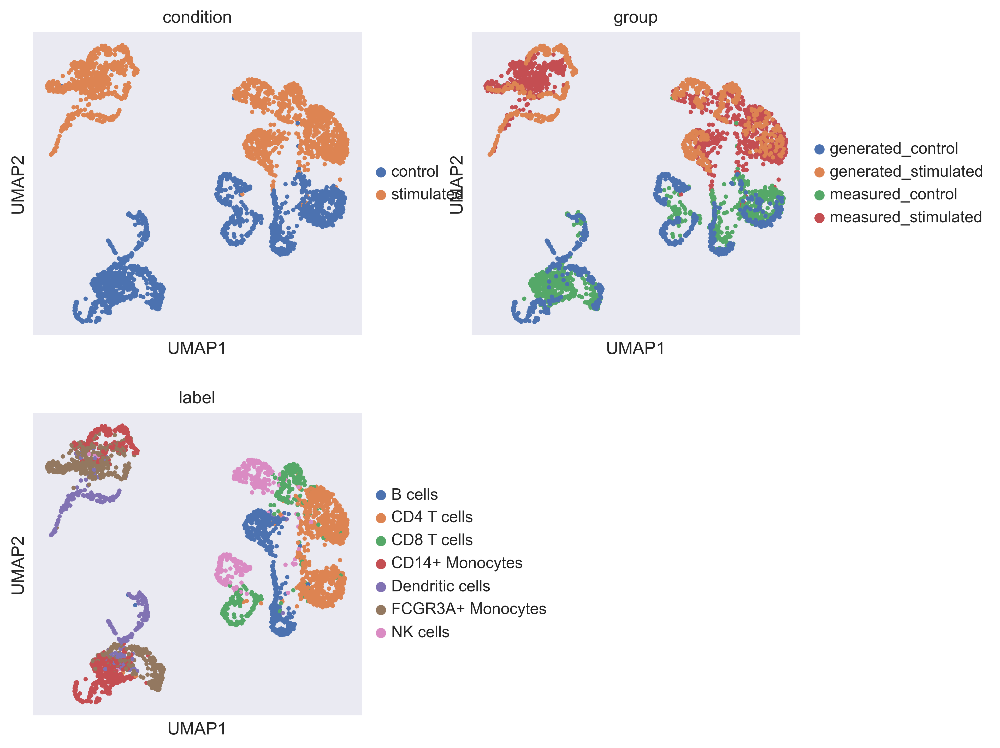

In [499]:
sc.pl.umap(xgdata,
           color=["condition", "group",
                  "label", ],
           ncols=2,
          )


In [511]:
labelskt[conditionskt == (0,1)].sum(0)
conditionskt == torch.tensor((0,1))
labelskt[(conditionskt == torch.tensor((0,1)))[:,0]].sum(0)
labelskv[(conditionskv == torch.tensor((0,1)))[:,0]].sum(0)

tensor([120.,  70., 388.,  76.,  56., 317.,  87.])

In [514]:
xgdata.obsm
xgdata.obs[["um1", "um2"]] = xgdata.obsm["X_umap"]

In [515]:
xgdata.obs

,condition,label,label_num,group,set,um1,um2
GACAGGGAATCTTC-1-control-0,control,FCGR3A+ Monocytes,5,measured_control,0,-0.414156,-3.851470
GTAGTGACTGACCA-1-control-0,control,CD14+ Monocytes,1,measured_control,0,-2.608394,-4.436783
CTTGATTGACTACG-1-control-0,control,CD4 T cells,2,measured_control,0,16.405445,1.438405
CGCAGGTGACGCTA-1-control-0,control,FCGR3A+ Monocytes,5,measured_control,0,14.818214,4.969618
TGGCACCTGGTAGG-1-stimulated-0,stimulated,FCGR3A+ Monocytes,5,measured_stimulated,0,-2.100843,13.614595
...,...,...,...,...,...,...,...
1395,control,CD4 T cells,2,generated_control,1,17.112434,1.470739
1396,control,CD8 T cells,3,generated_control,1,9.630195,-0.637685
1397,control,Dendritic cells,4,generated_control,1,-1.034967,-2.054272
1398,control,FCGR3A+ Monocytes,5,generated_control,1,0.097681,-2.838481


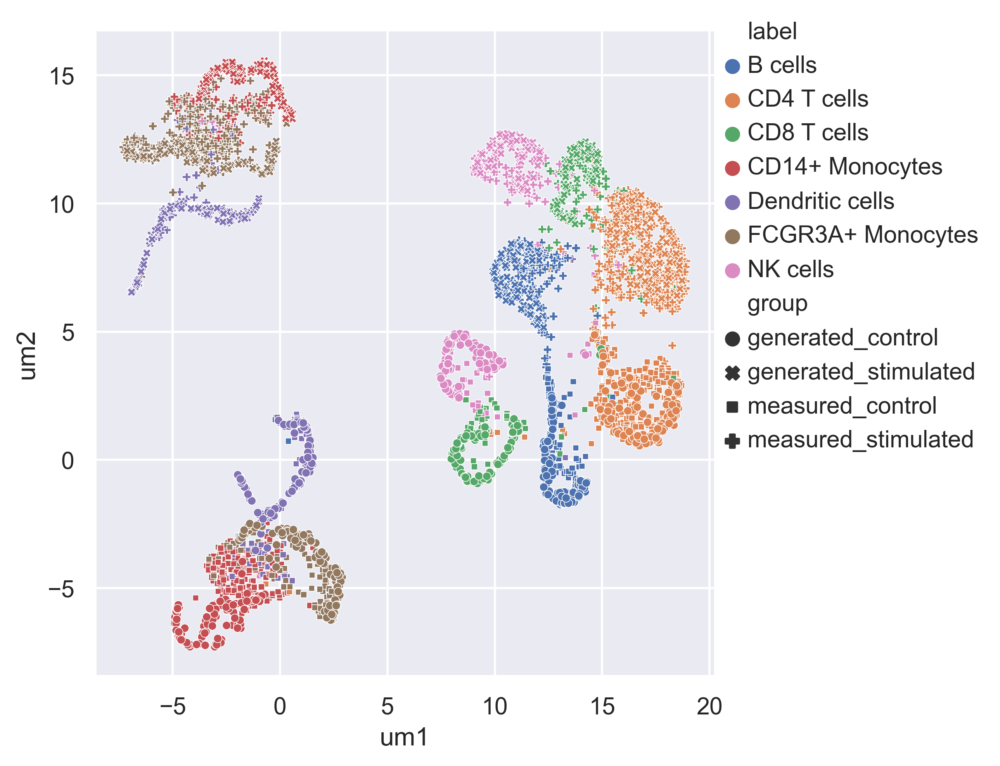

In [517]:
ax=sns.relplot(
    data=xgdata.obs,
    x="um1",
    y="um2",
    hue="label",
    style="group",
    s=1.5e1,
)
sns.move_legend(ax, "upper right",)